In [1]:
import copy
import io
import json
from collections import defaultdict

import click
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import rcParams
from matplotlib.backends.backend_pdf import PdfPages
from openff.toolkit.topology import Molecule
from PIL import Image
from simtk import unit
from tabulate import tabulate
from visualization import show_oemol_struc
from cinnabar.stats import bootstrap_statistic

/tmp/ipykernel_781488/2008625819.py:9: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
PARTICLE = unit.mole.create_unit(
    6.02214076e23 ** -1,
    "particle",
    "particle",
)
HARTREE_PER_PARTICLE = unit.hartree / PARTICLE
HARTREE_TO_KCALMOL = HARTREE_PER_PARTICLE.conversion_factor_to(
    unit.kilocalorie_per_mole
)
ESU_BOHR = unit.elementary_charge * unit.bohr
ESU_BOHR_TO_DEBYE = ESU_BOHR.conversion_factor_to(unit.debye)
BOLTZMANN_CONSTANT = unit.constants.BOLTZMANN_CONSTANT_kB
REF_SPEC = 'mp2/heavy-aug-cc-pv[tq]z + d:ccsd(t)/heavy-aug-cc-pvdz'

In [3]:
def diff_between_vectors(vec1, vec2):
    """
    gives out the magnitude difference and angle between vectors
    :param vec1:
    :param vec2:
    :return:
    """
    mu1 = np.linalg.norm(vec1)
    mu2 = np.linalg.norm(vec2)
    mu_diff = mu1 - mu2
    unit_vector_1 = vec1 / mu1
    unit_vector_2 = vec2 / mu2
    dot_product = np.dot(unit_vector_1, unit_vector_2)
    angle = np.pi * np.arccos(
        np.round(dot_product, decimals=8))  # * unit.degrees
    return mu_diff, angle

In [4]:
rcParams.update({"font.size": 12})
KELLYS_COLORS = [
    "#ebce2b",
    "#db6917",
    "#96cde6",
    "#ba1c30",
    "#c0bd7f",
    "#7f7e80",
    "#5fa641",
    "#d485b2",
    "#4277b6",
    "#92ae31",
    "#463397",
    "#e1a11a",
    "#6f340d",
    "#e8e948",
    "#d32b1e",
    "#df8461",
    "#2b3514",
    "#702c8c",
    "#7e1510",
    "#91218c",
    "#01a263",
    "#fecb00",
    "#cd0d2d",
    "#00247d"
]
pdf = PdfPages("./output/dipoles_profiles_all_methods.pdf")
# for the sake of querying convenience listing out the keywords, methods and basis_sets sets explicitly
keywords_list = [
    "b97-d3bj/def2-tzvp",
    "m05-2x-d3/dzvp",
    "m06-2x-d3/dzvp",
    "m08-hx-d3/dzvp",
    # "wb97x-d3bj/dzvp", commented out since the dispersion energies are not handled properly in current qcf 
    # version 
    # for this functional
    "wb97m-d3bj/dzvp",
    "wb97m-v/dzvp",
    "pw6b95-d3bj/dzvp",
    "pw6b95-d3/dzvp",
    "mp2/aug-cc-pvtz",
    "mp2/heavy-aug-cc-pvtz",
    "dsd-blyp-d3bj/heavy-aug-cc-pvtz",
    "b3lyp-d3bj/dzvp",
    "b3lyp-nl/dzvp",
    "b3lyp-d3bj/def2-tzvp",
    "b3lyp-d3bj/def2-tzvpd",
    "b3lyp-d3bj/def2-tzvpp",
    "b3lyp-d3bj/def2-tzvppd",
    "b3lyp-d3bj/def2-qzvp",
    "b3lyp-d3bj/6-31+g**",
    "b3lyp-d3bj/6-311+g**",
]

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

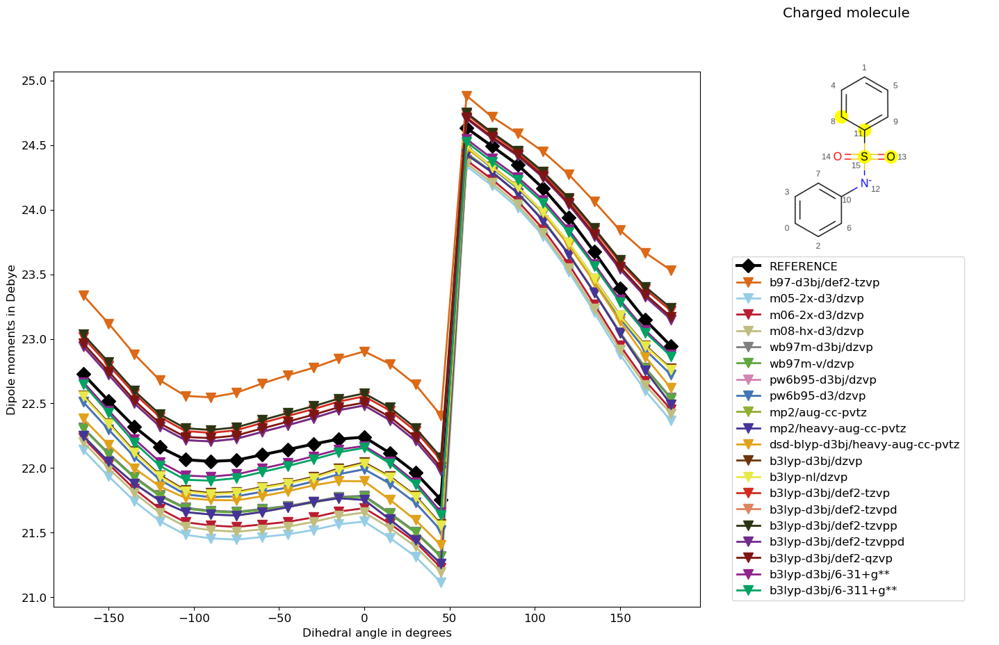

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

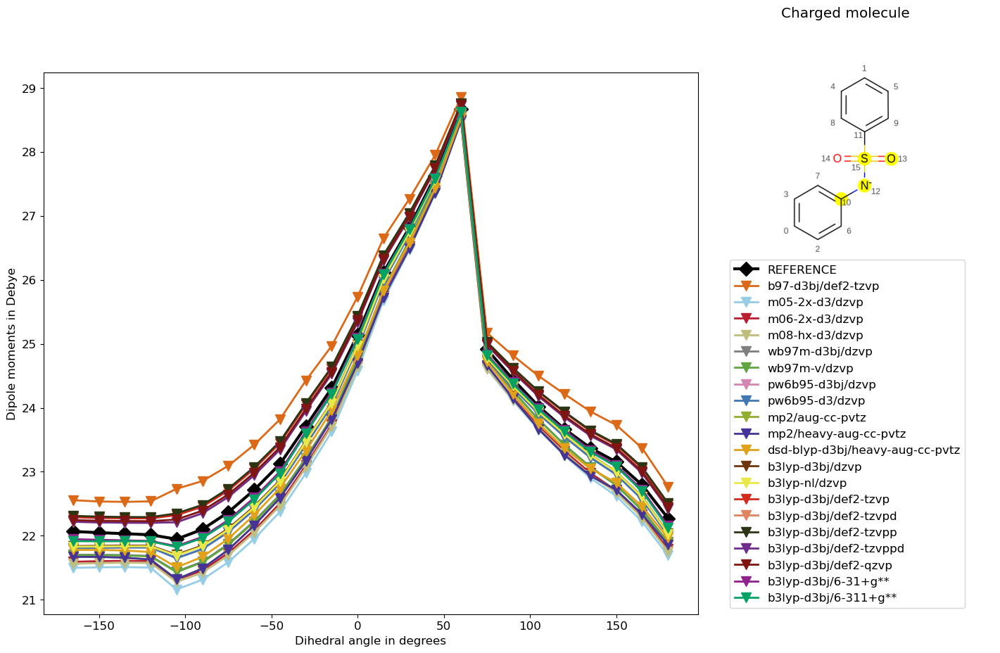

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

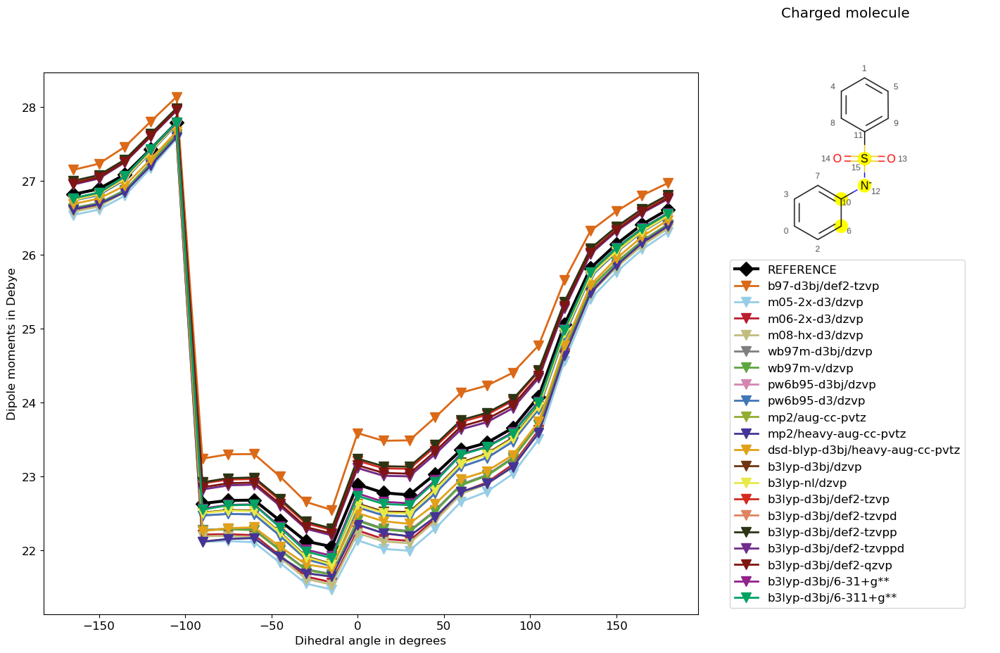

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

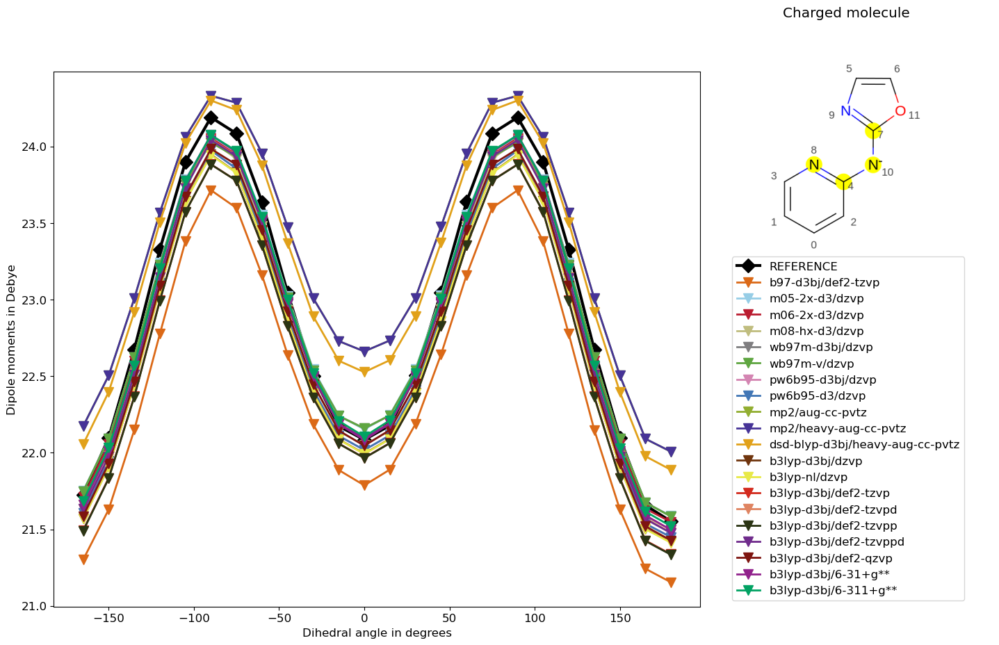

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

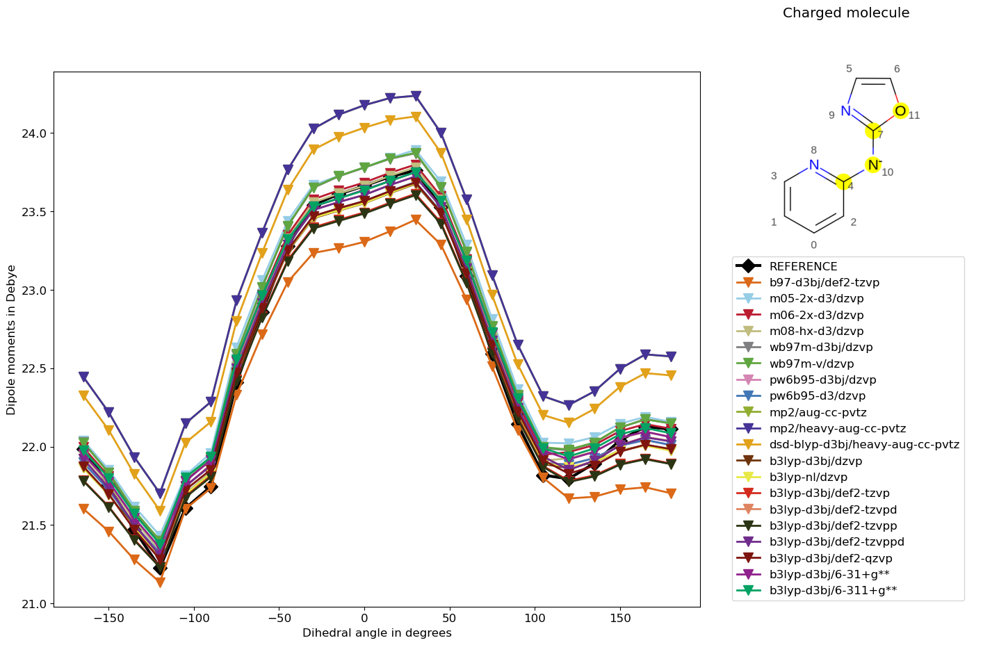

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

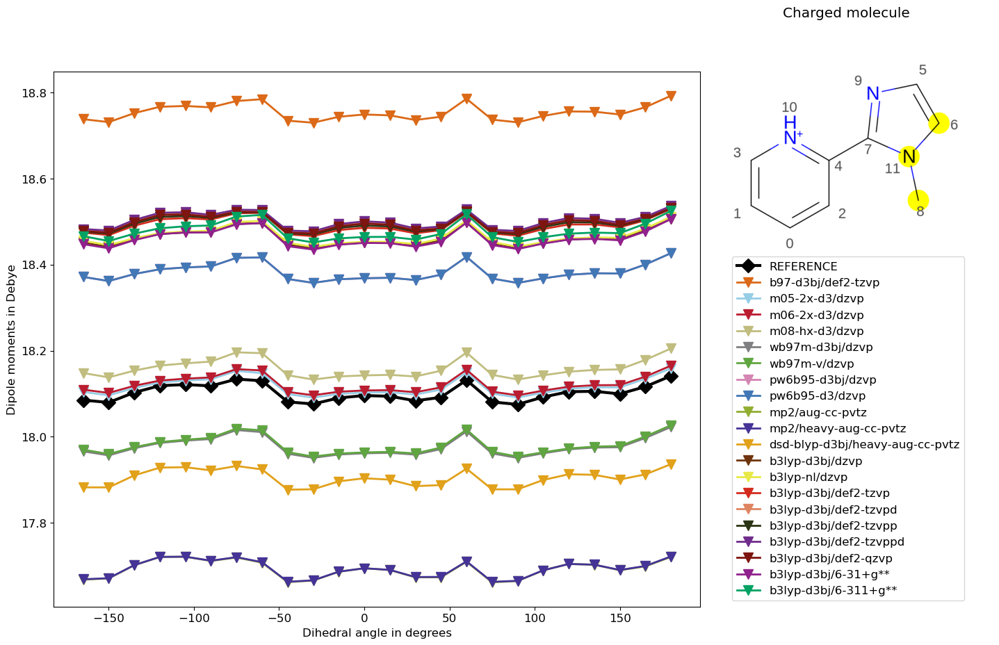

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

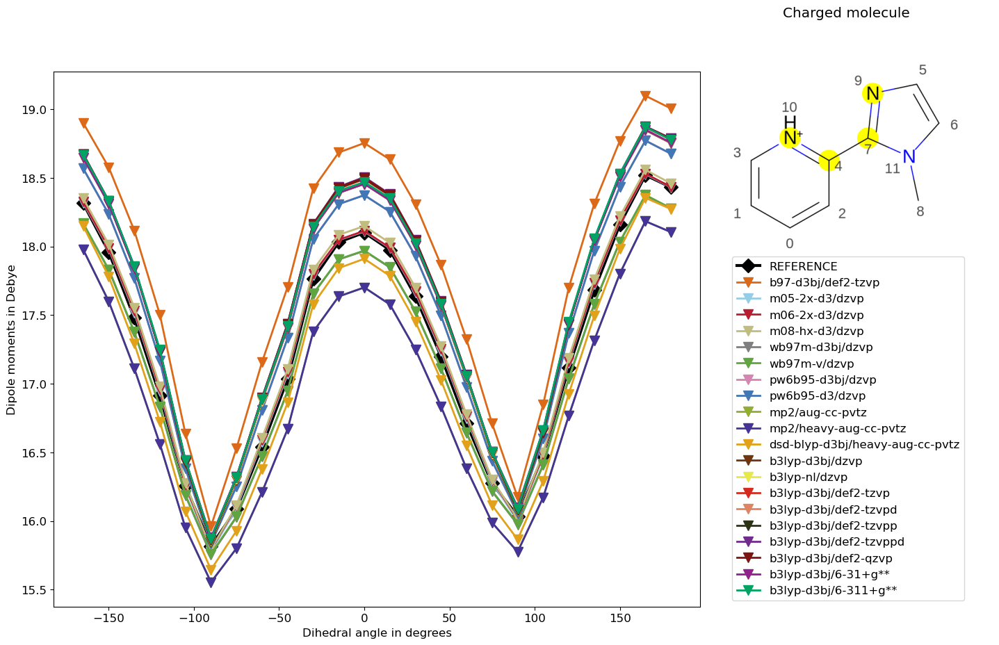

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

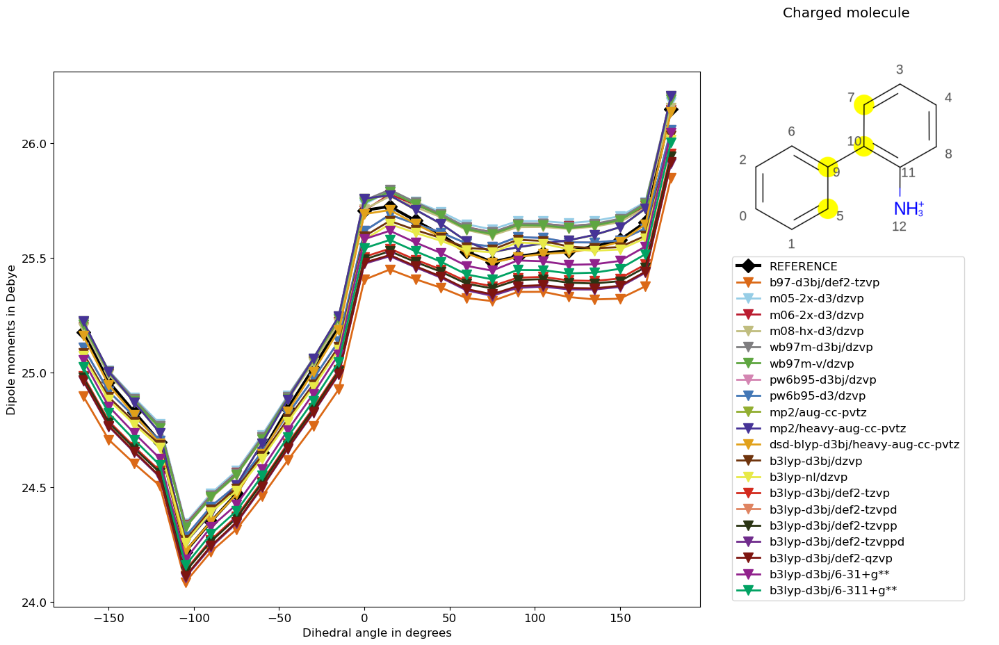

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

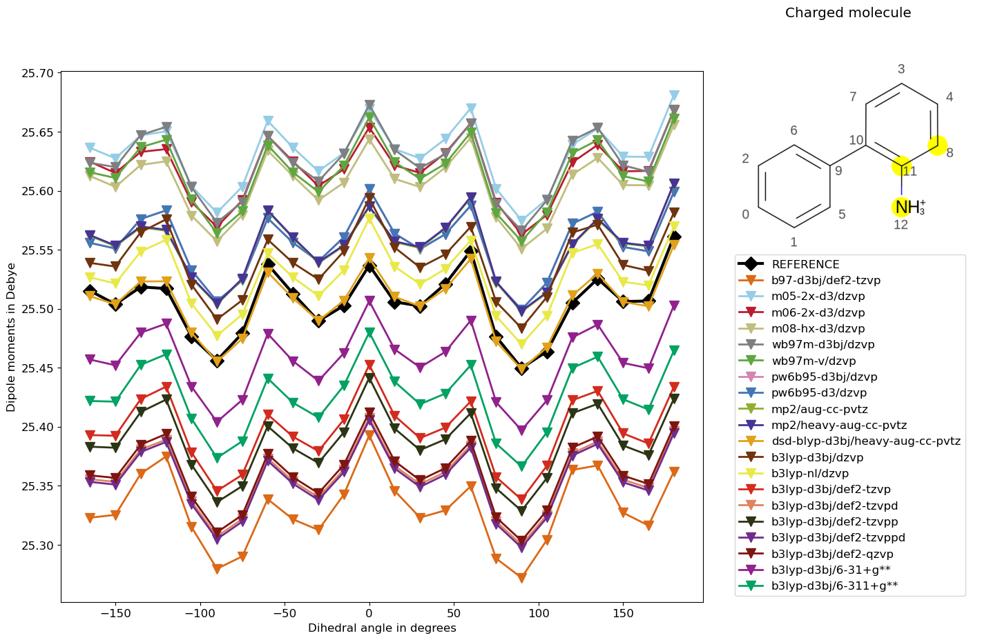

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

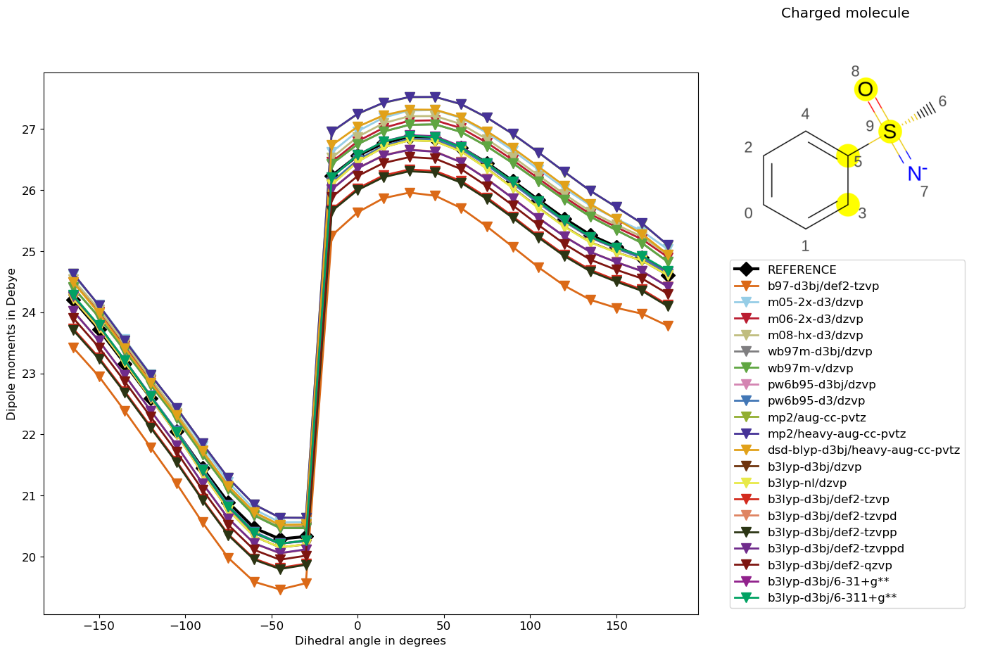

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

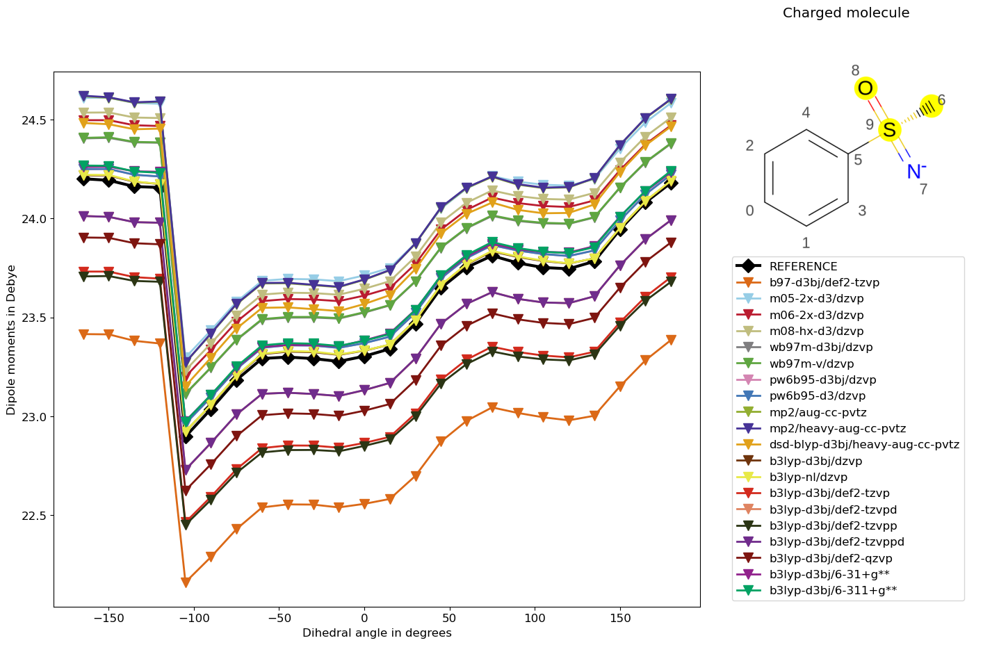

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

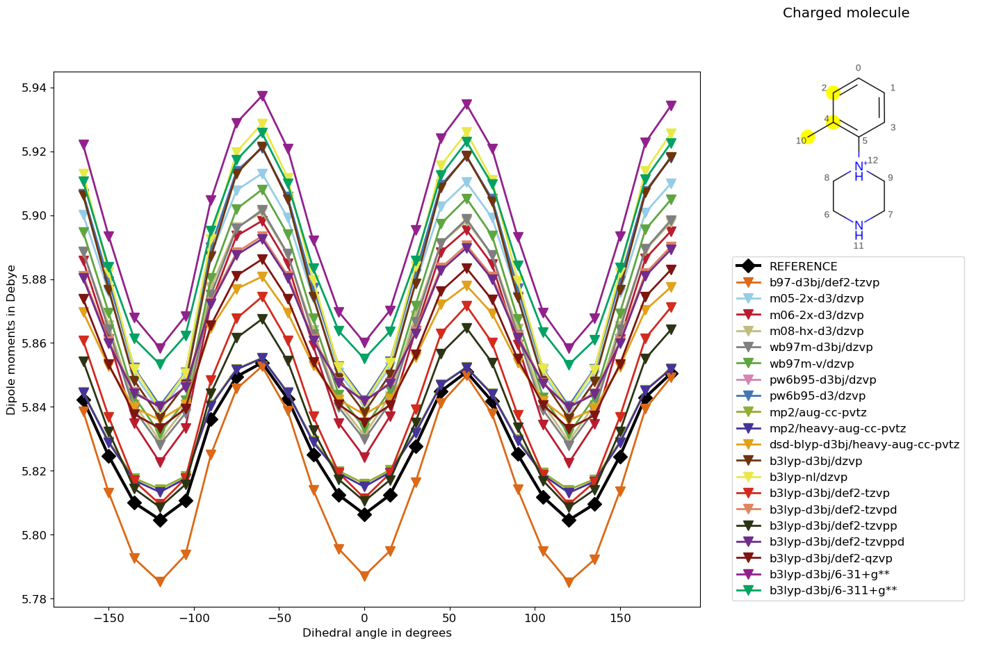

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

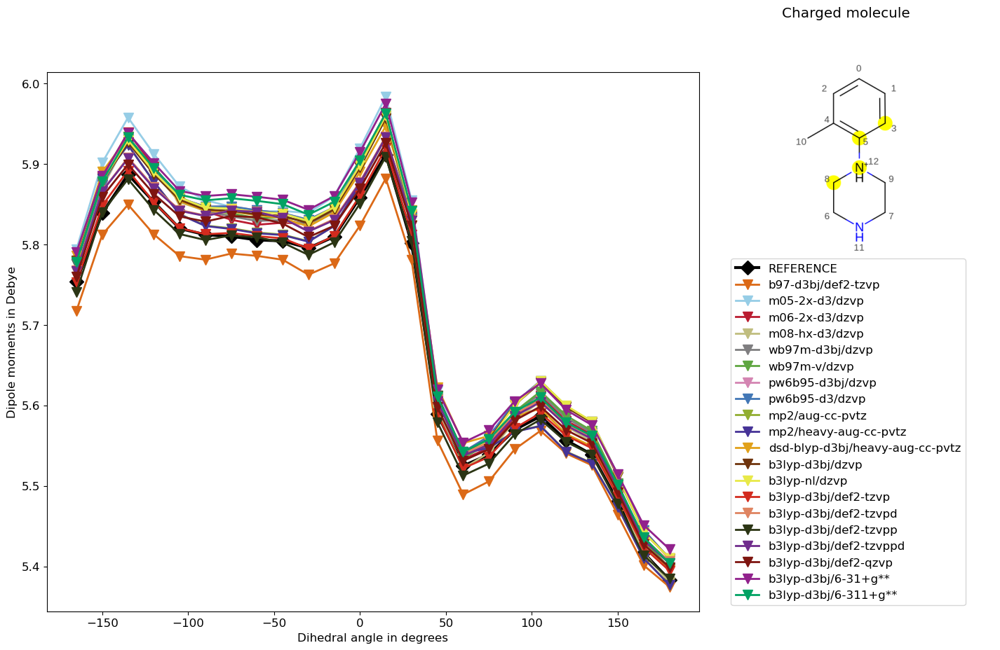

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

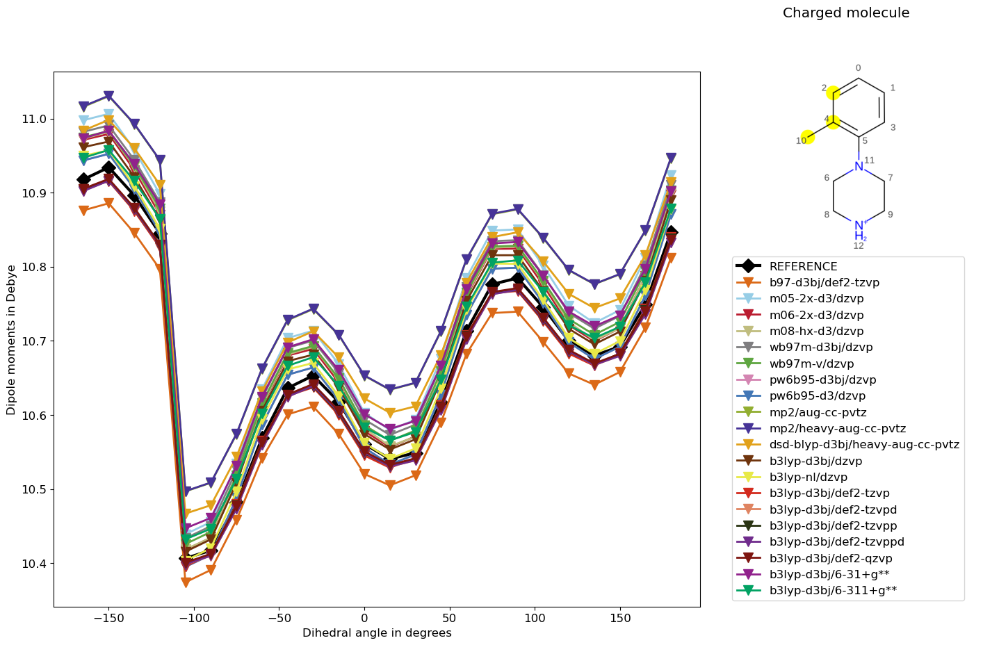

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

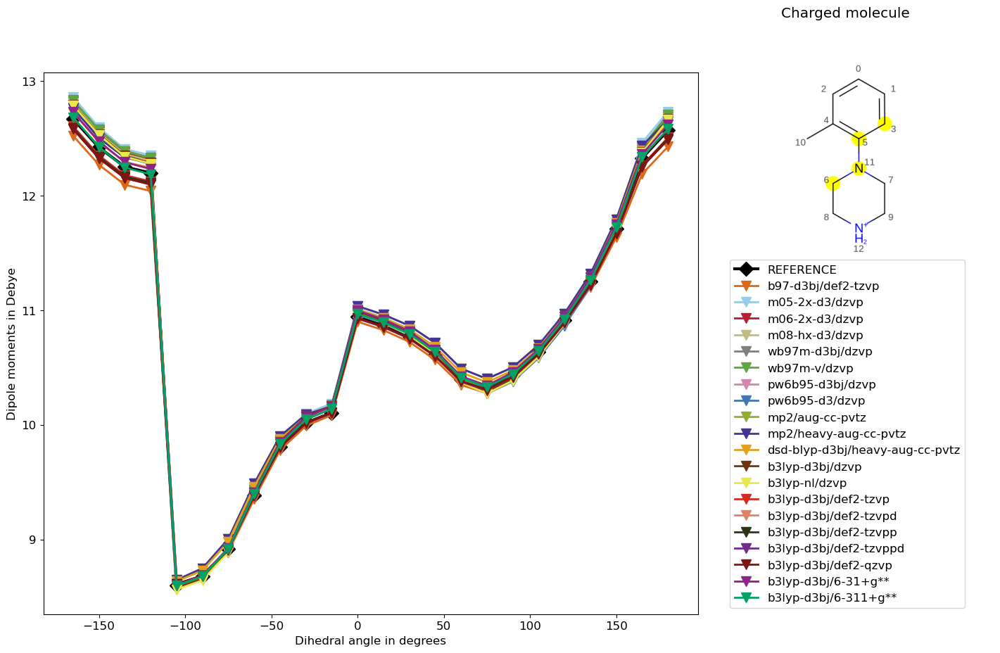

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

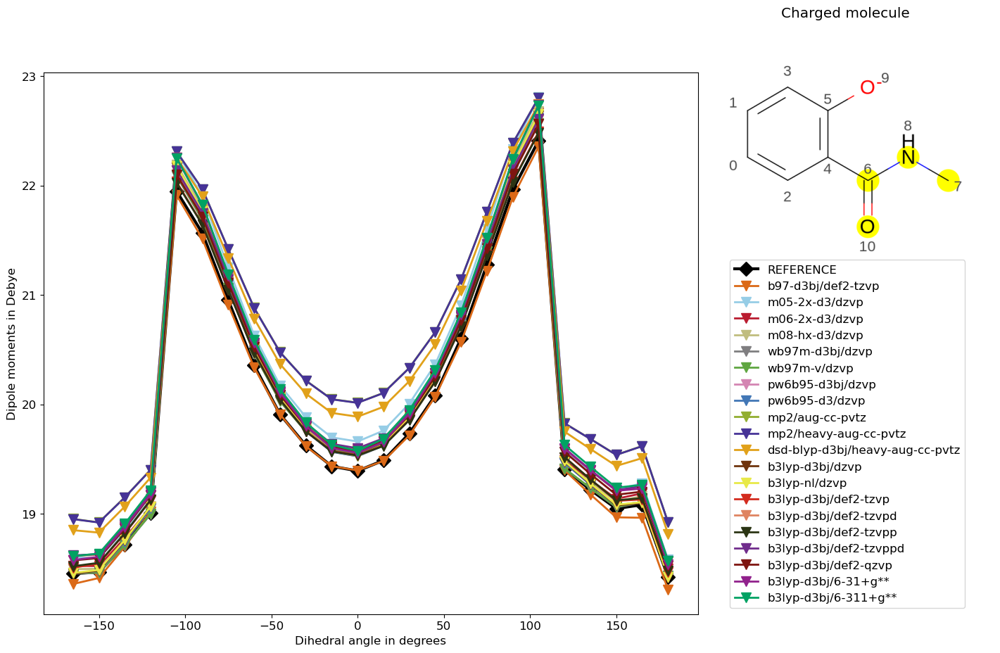

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

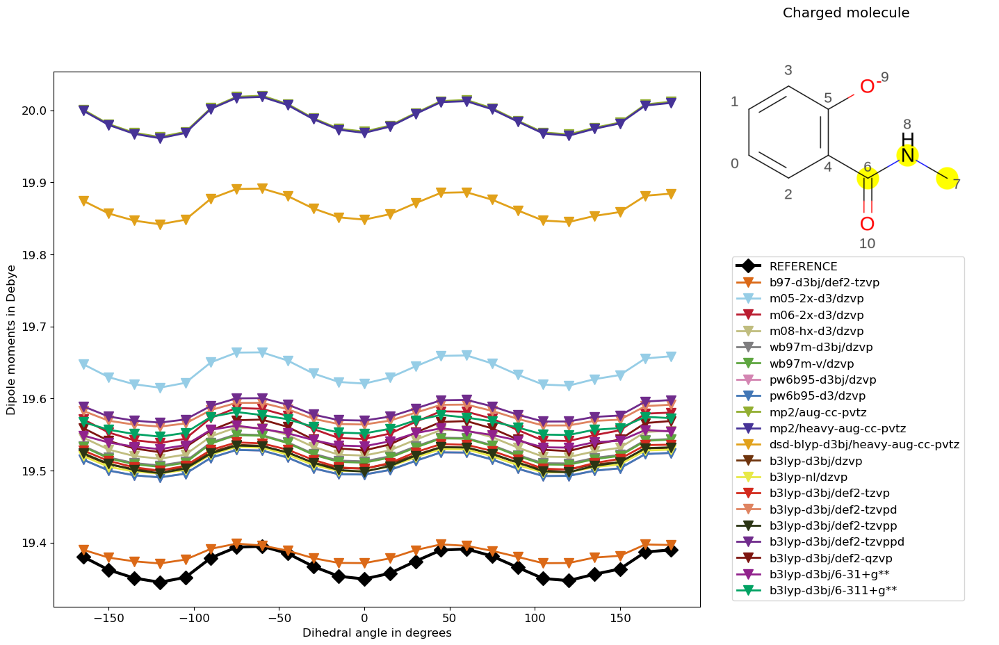

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

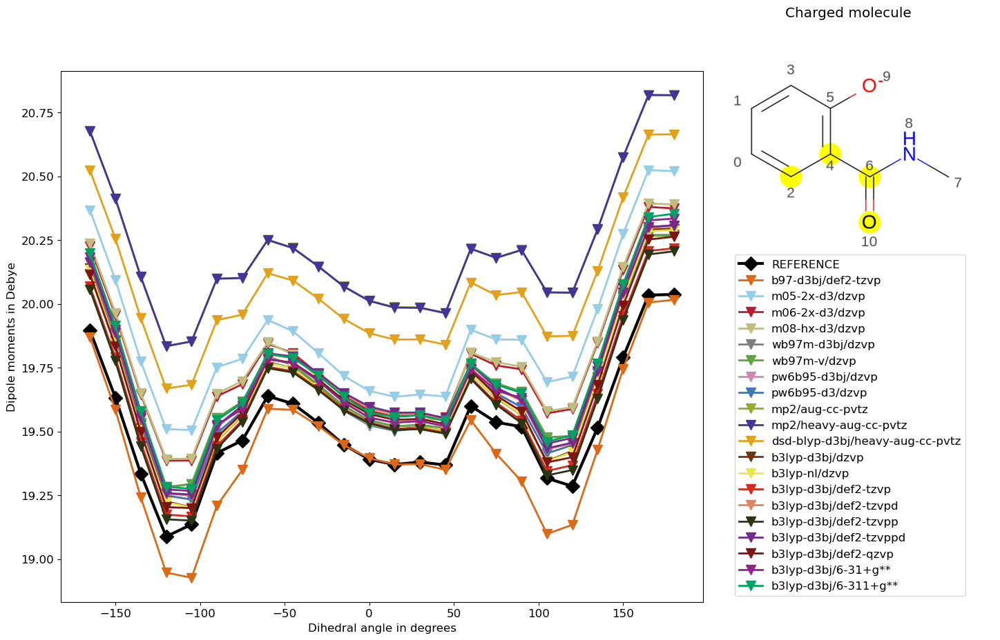

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

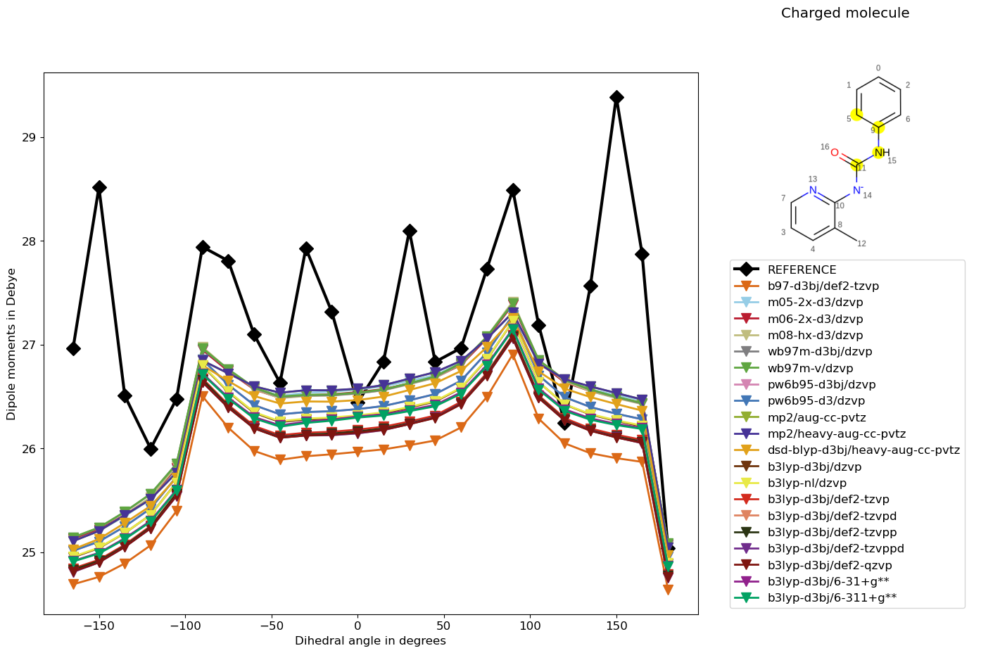

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

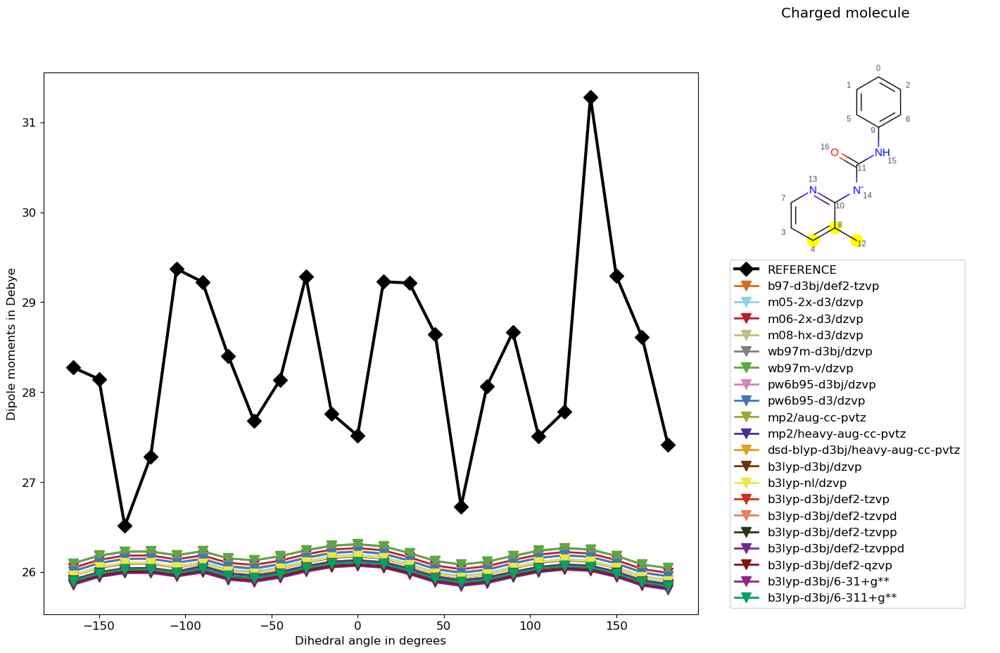

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

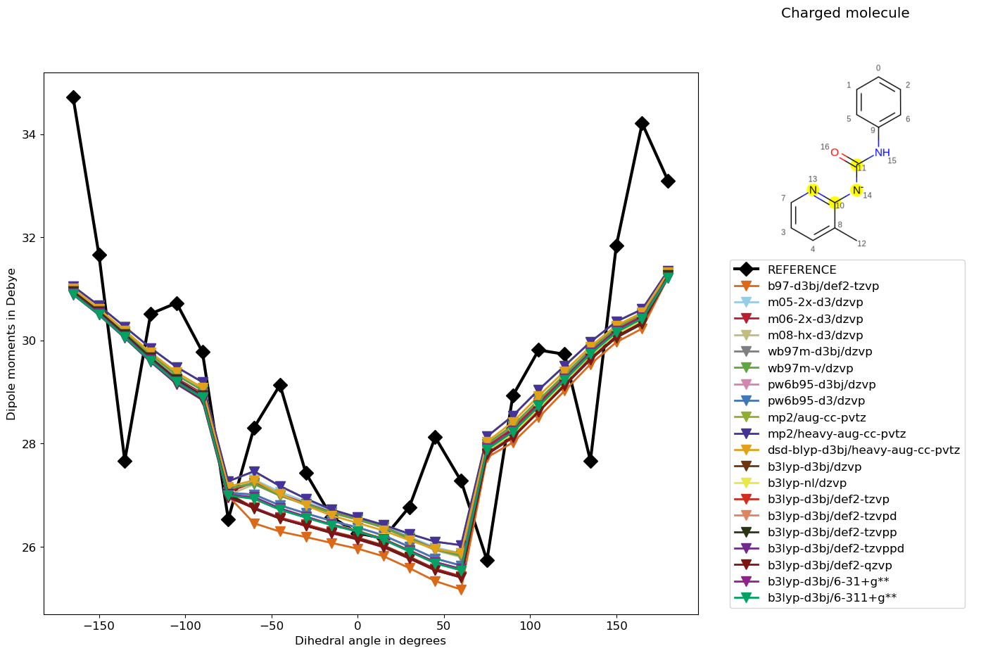

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

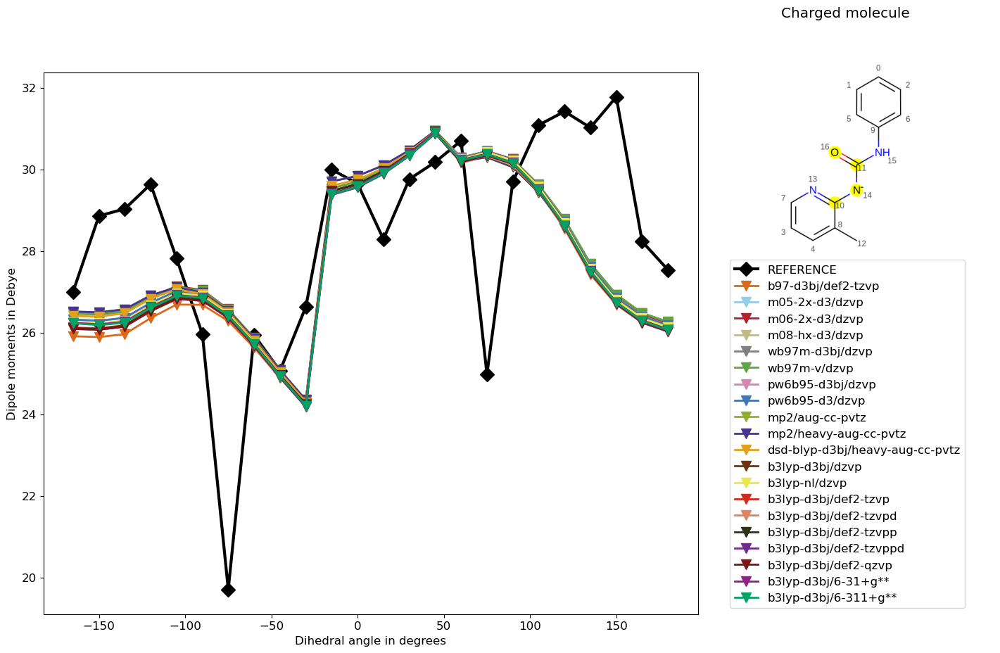

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

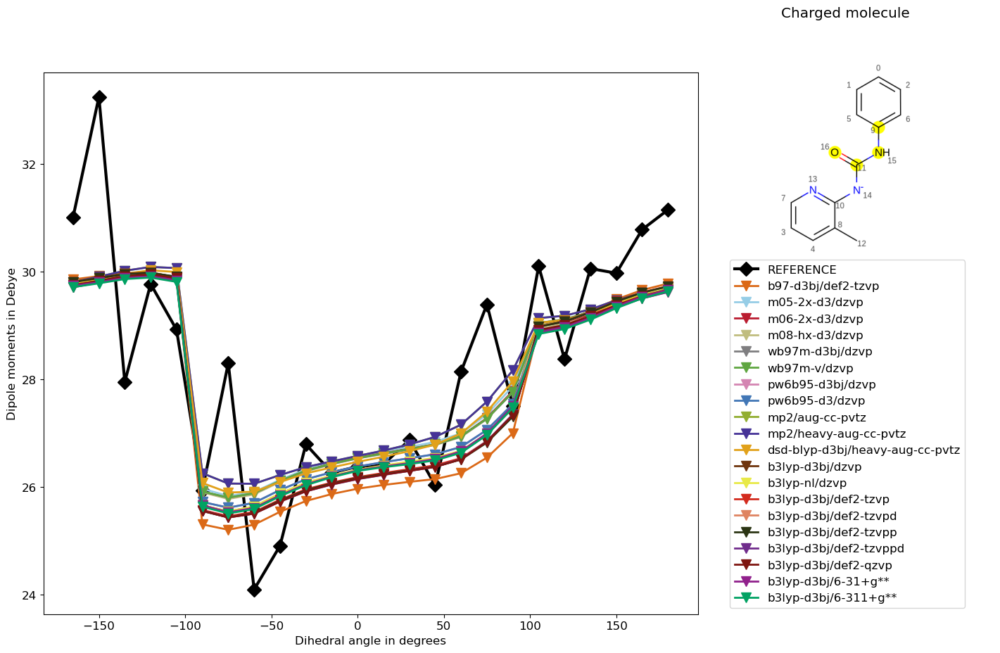

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

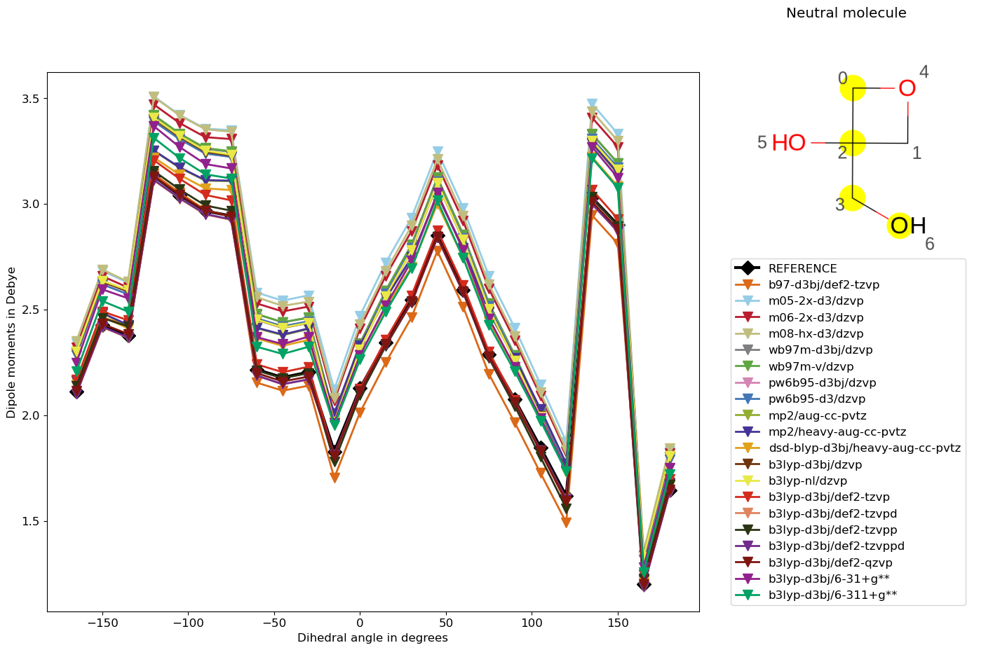

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

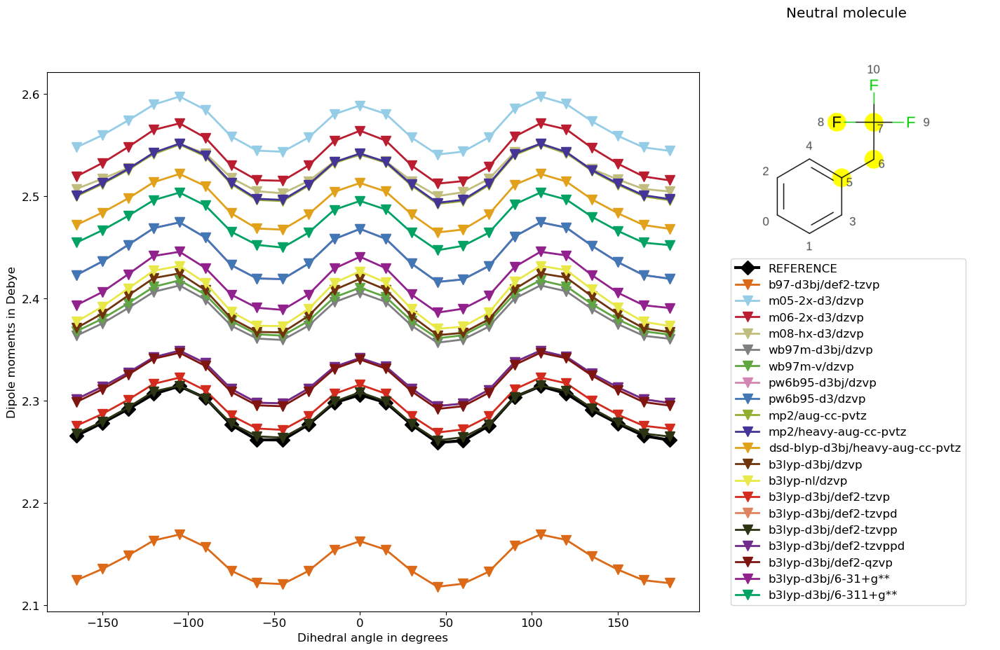

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

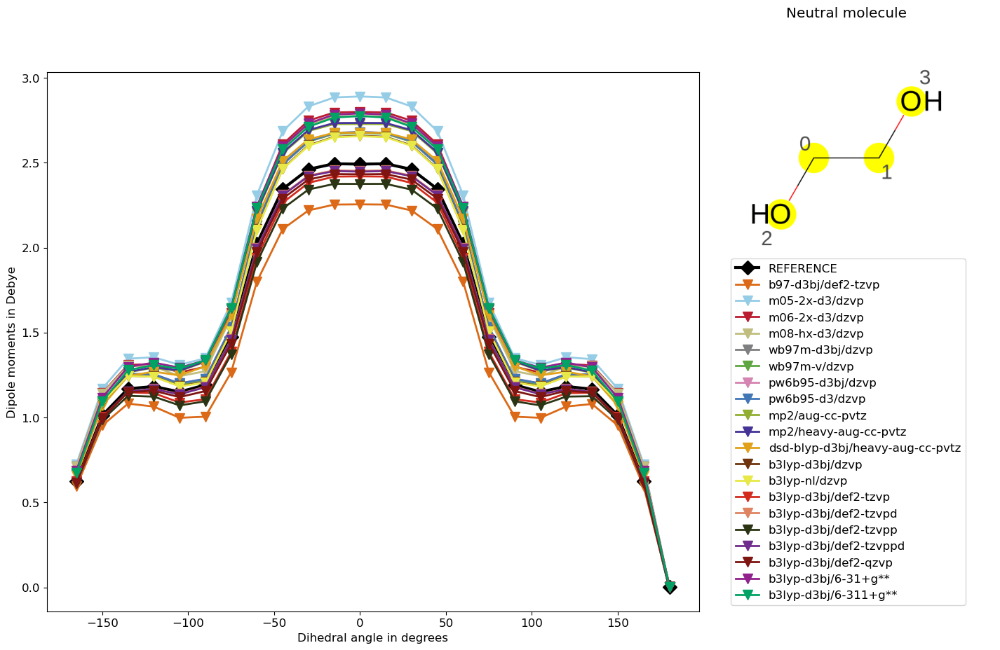

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

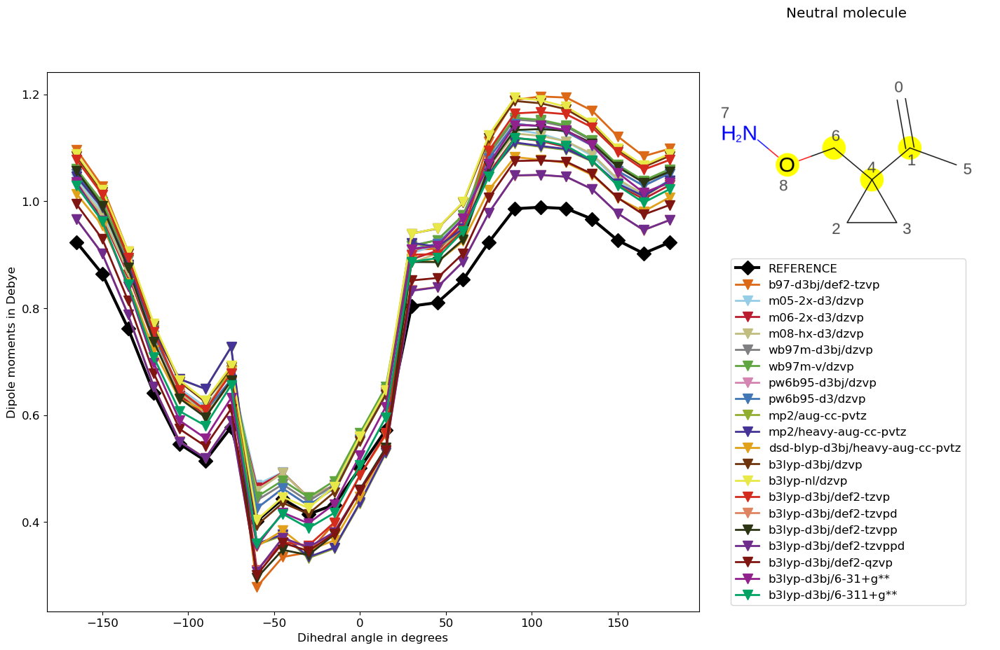

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

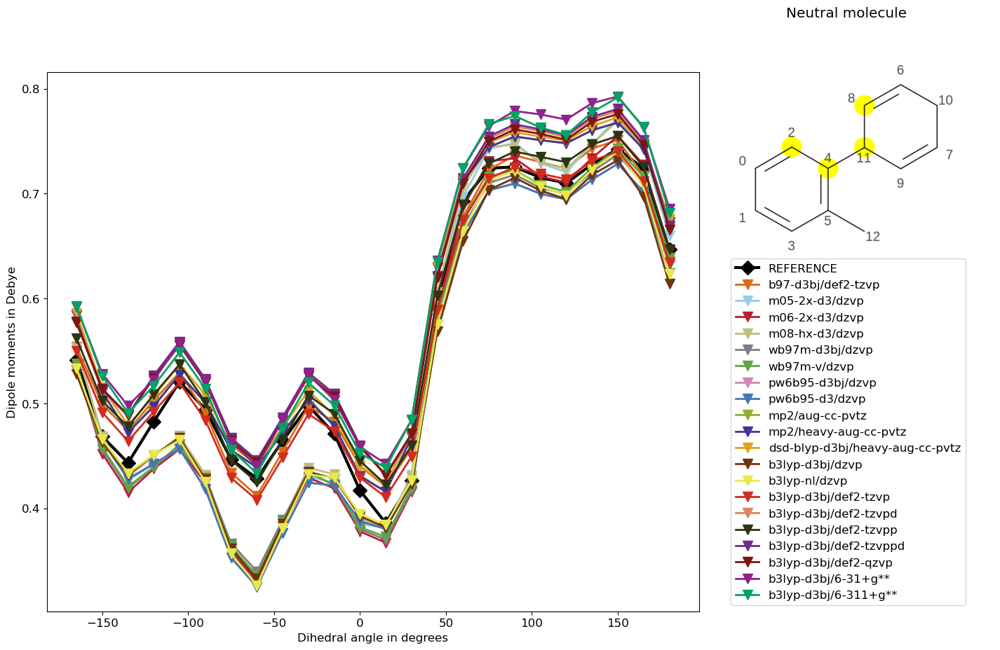

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

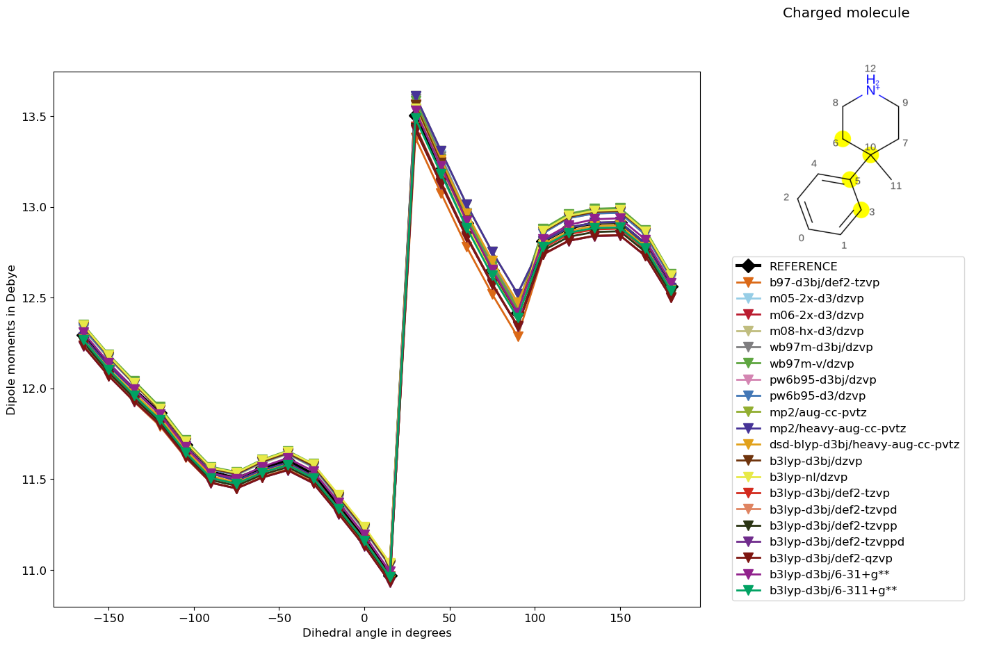

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

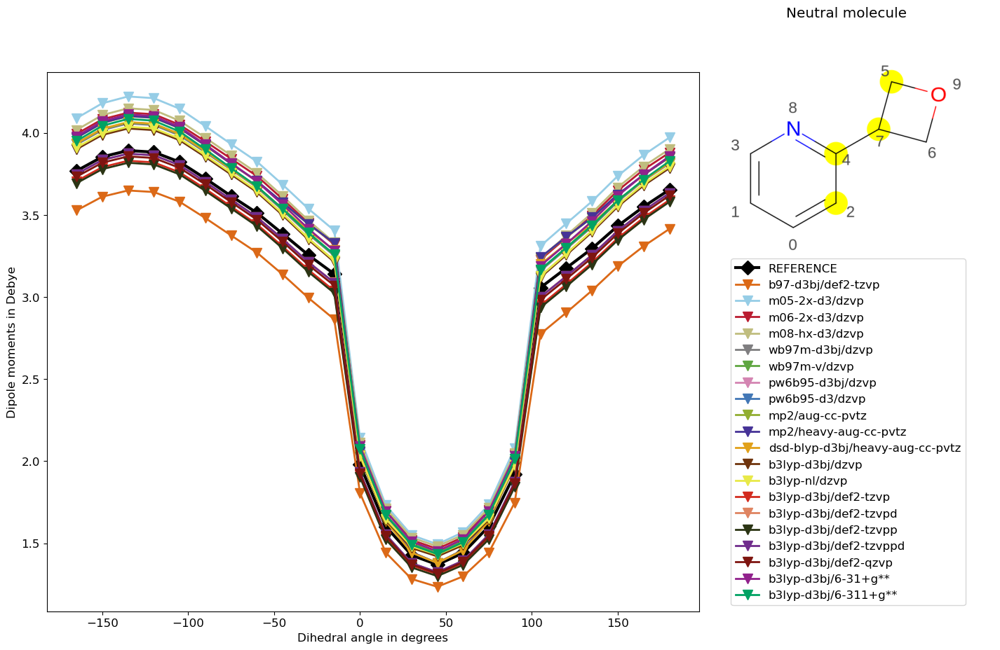

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

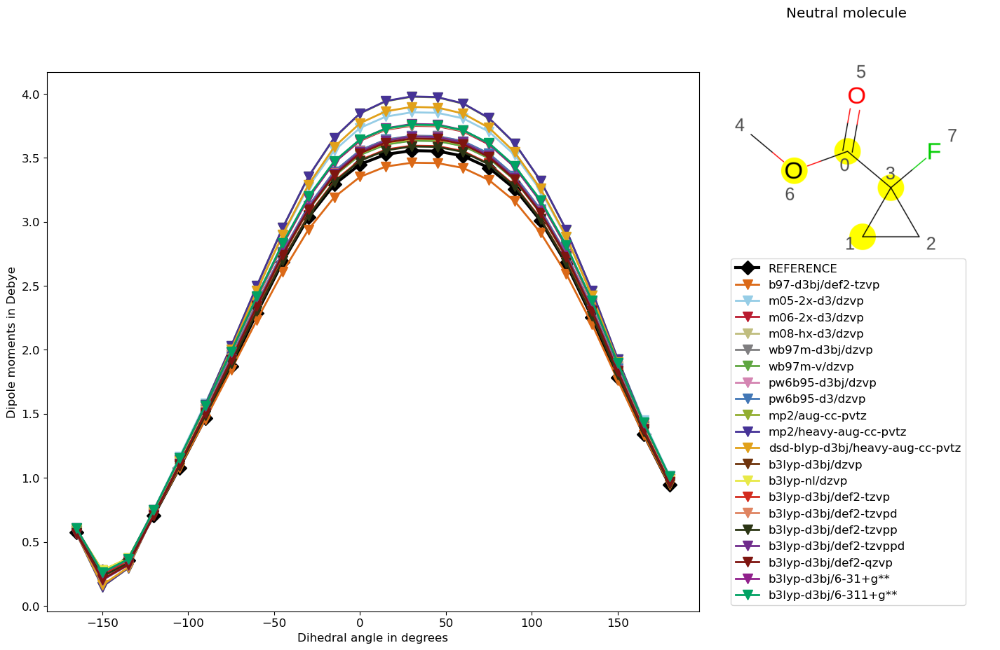

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

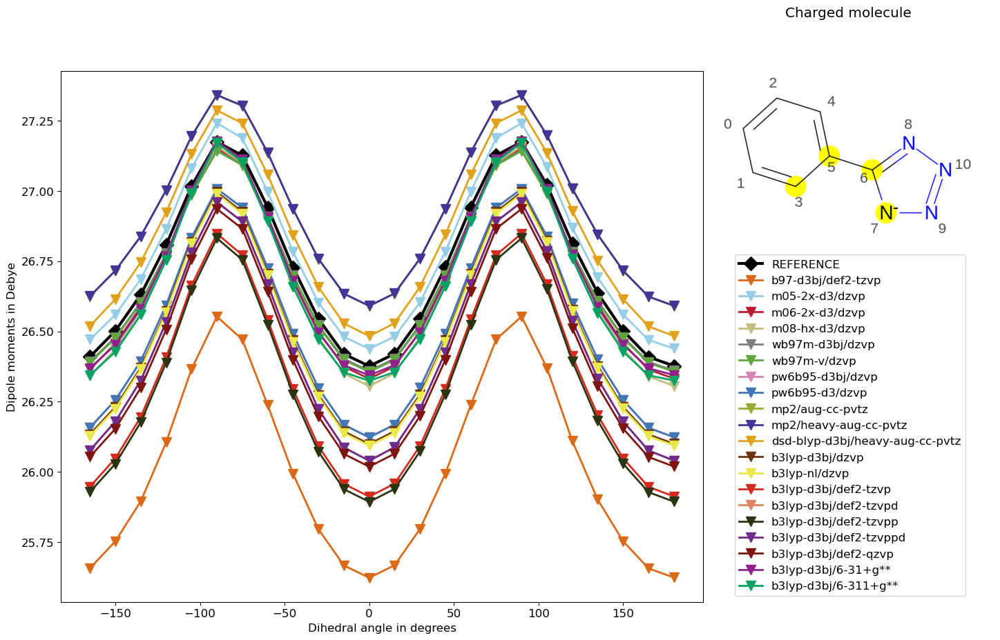

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

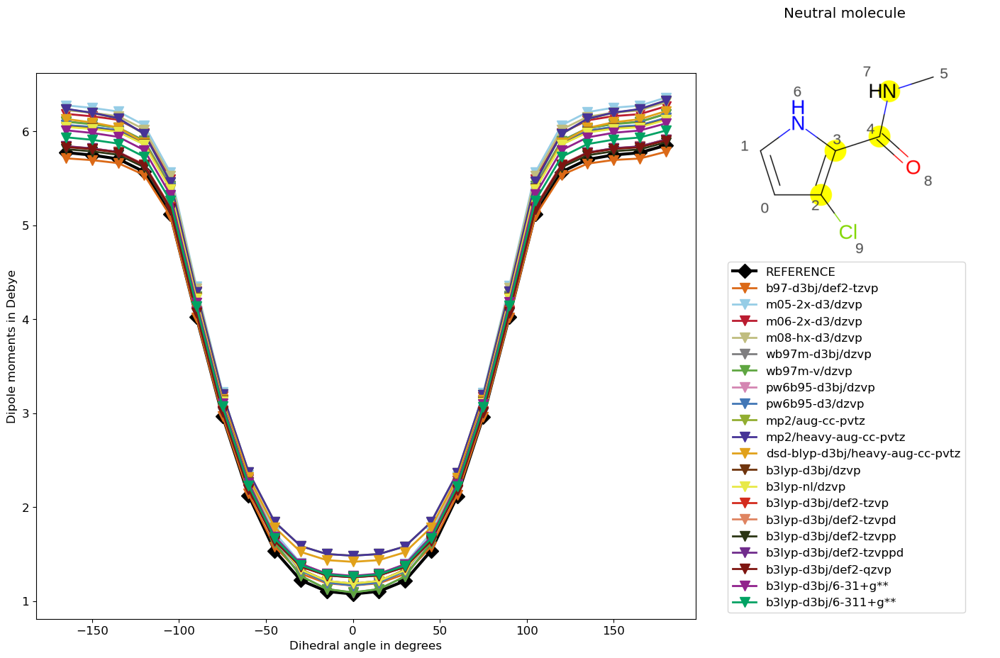

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

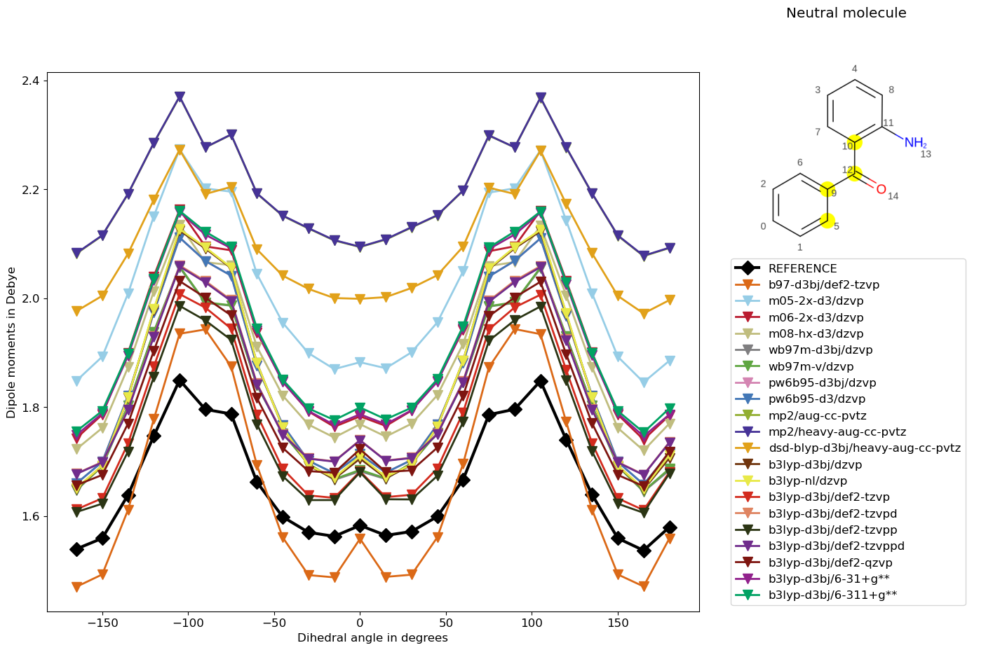

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

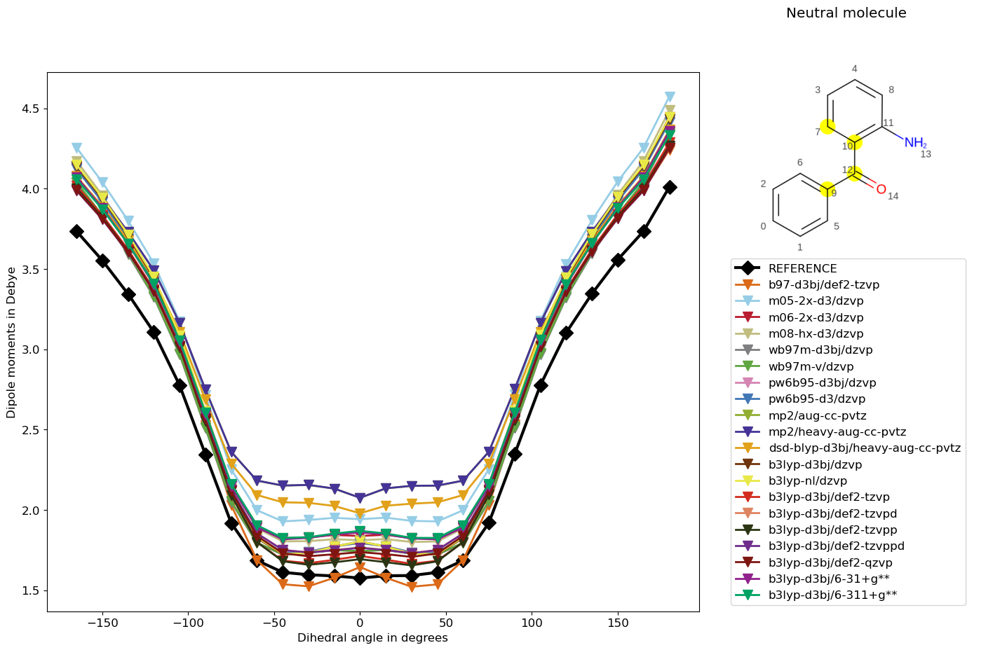

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

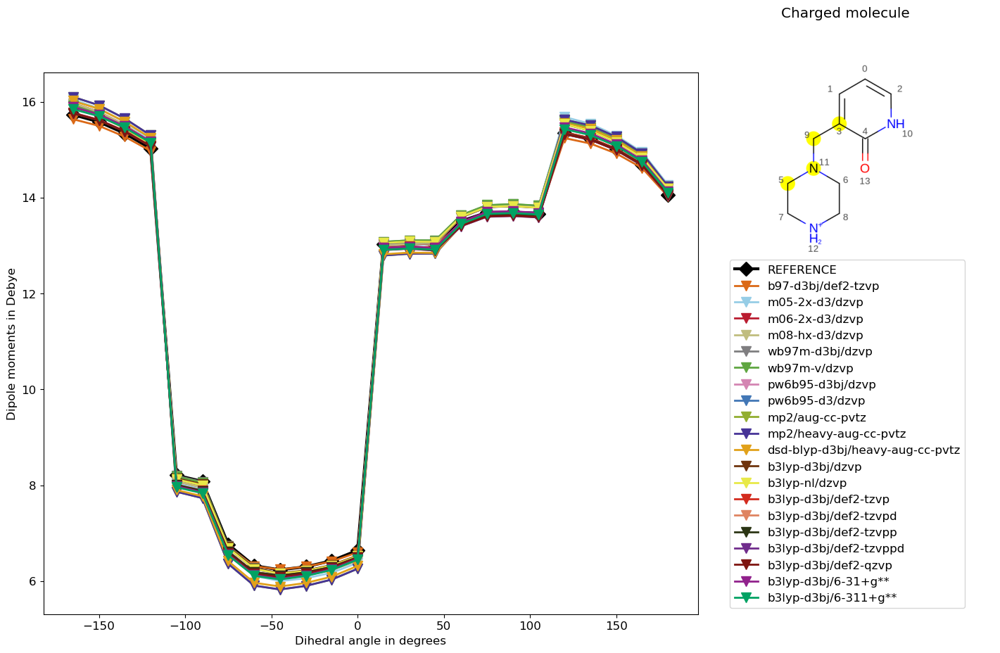

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

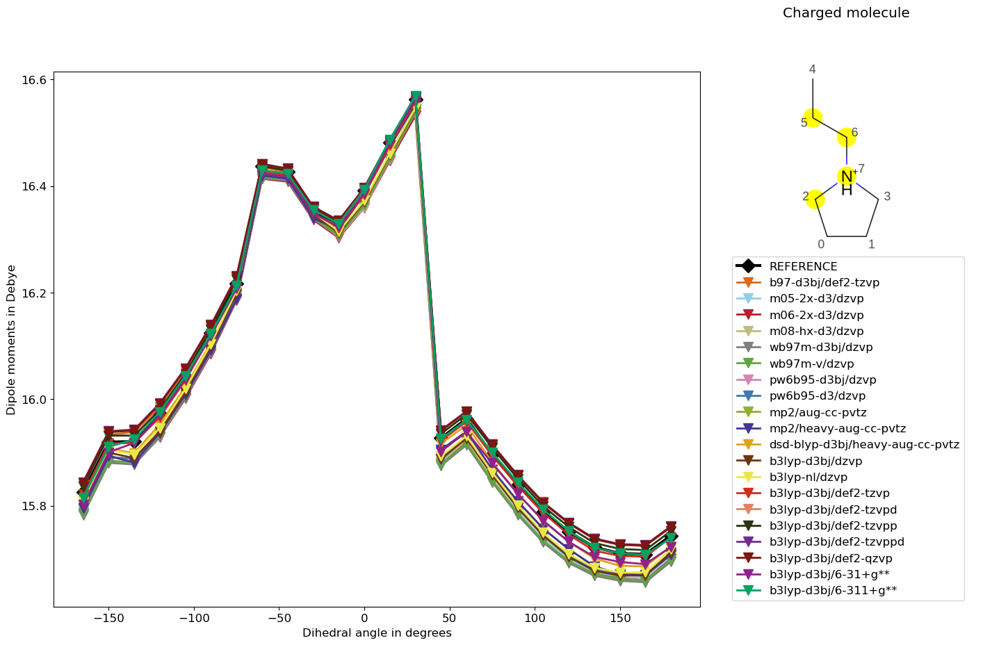

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

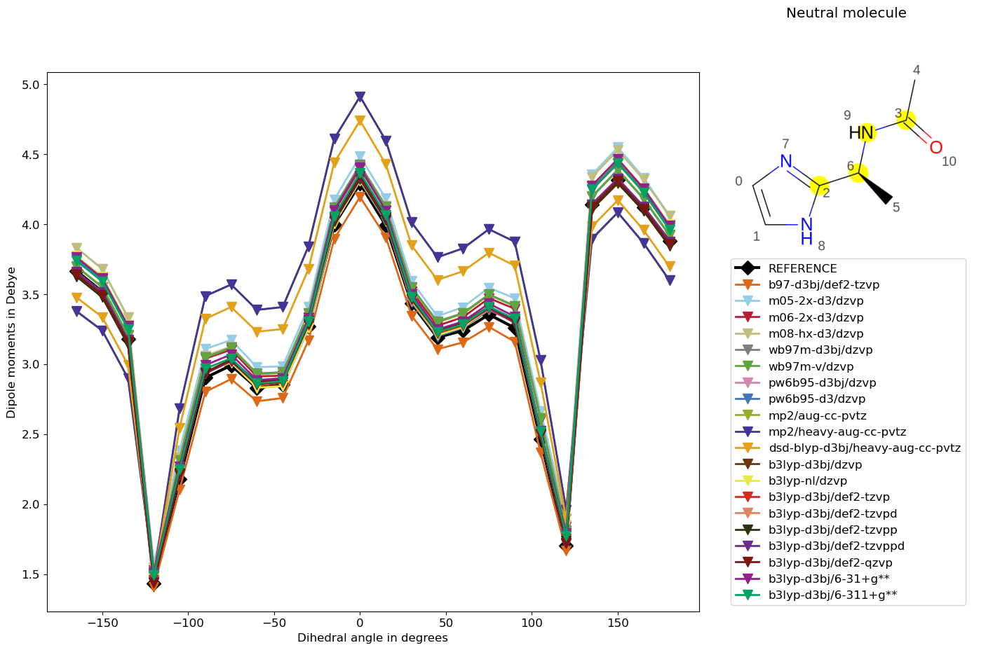

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

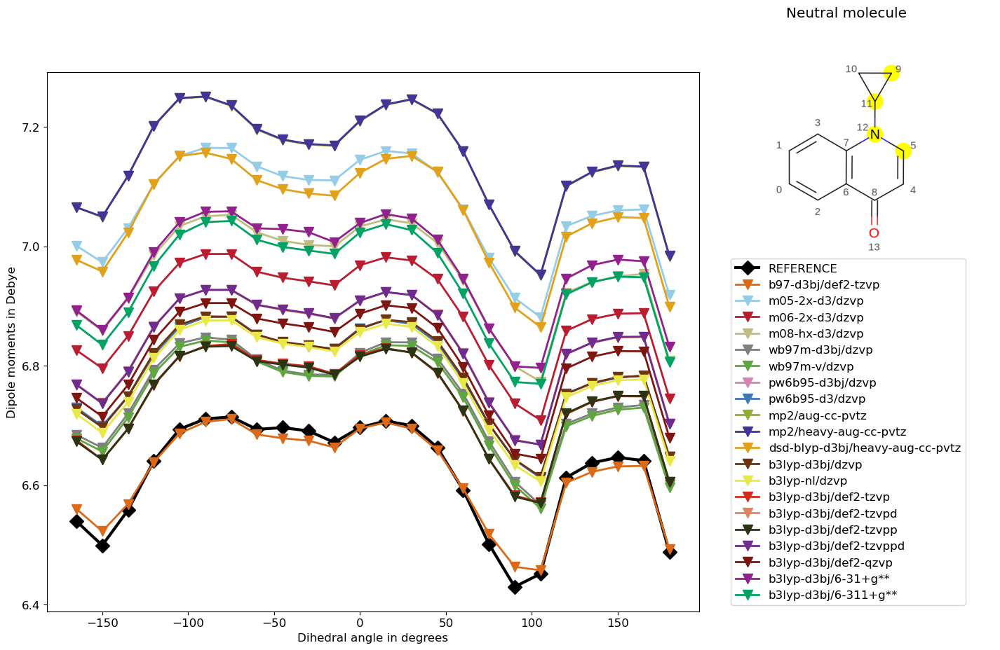

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

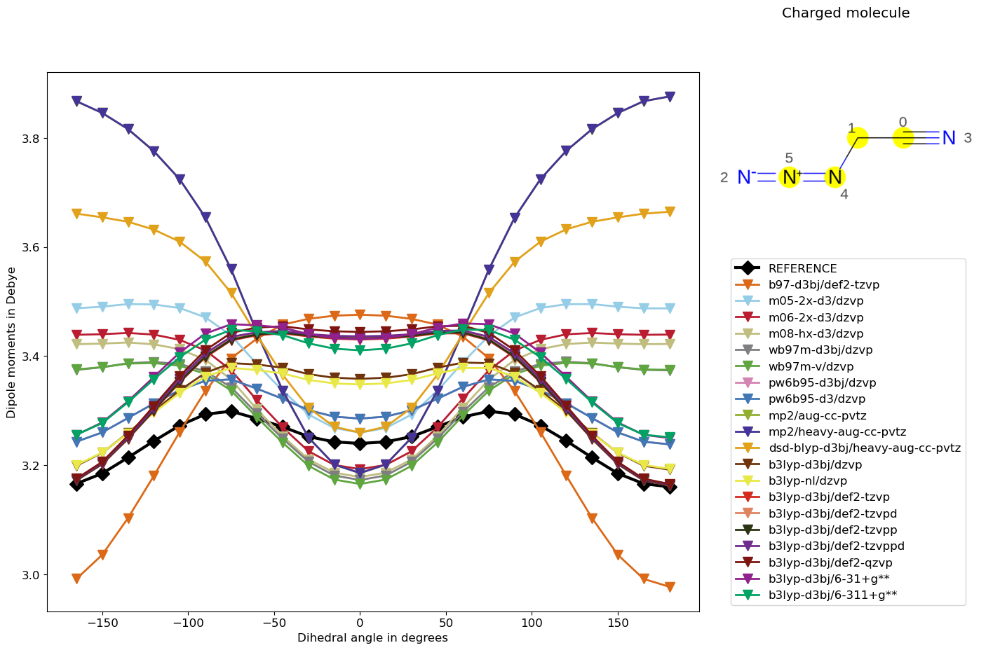

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

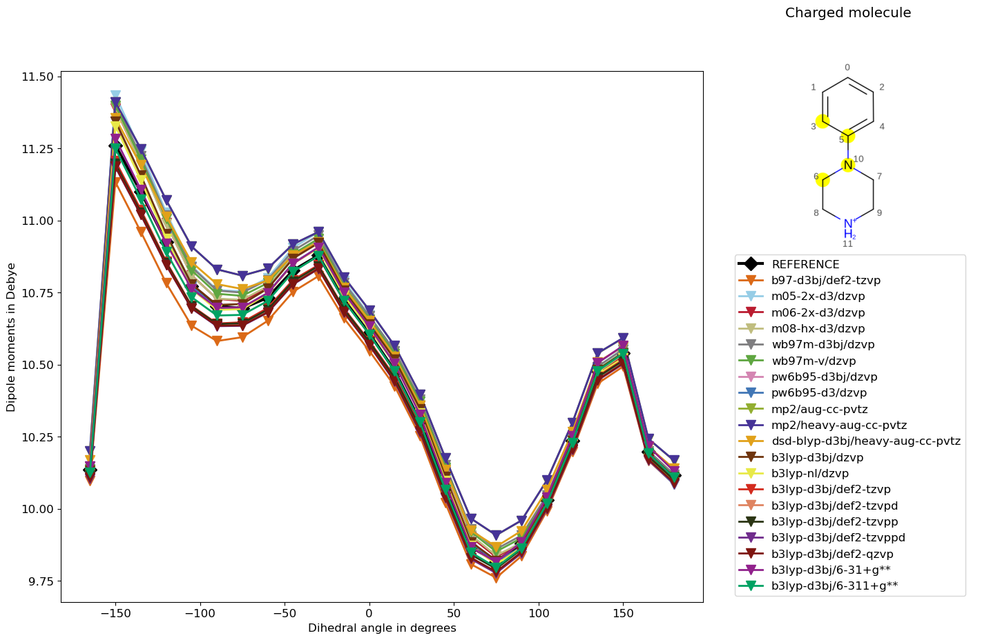

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

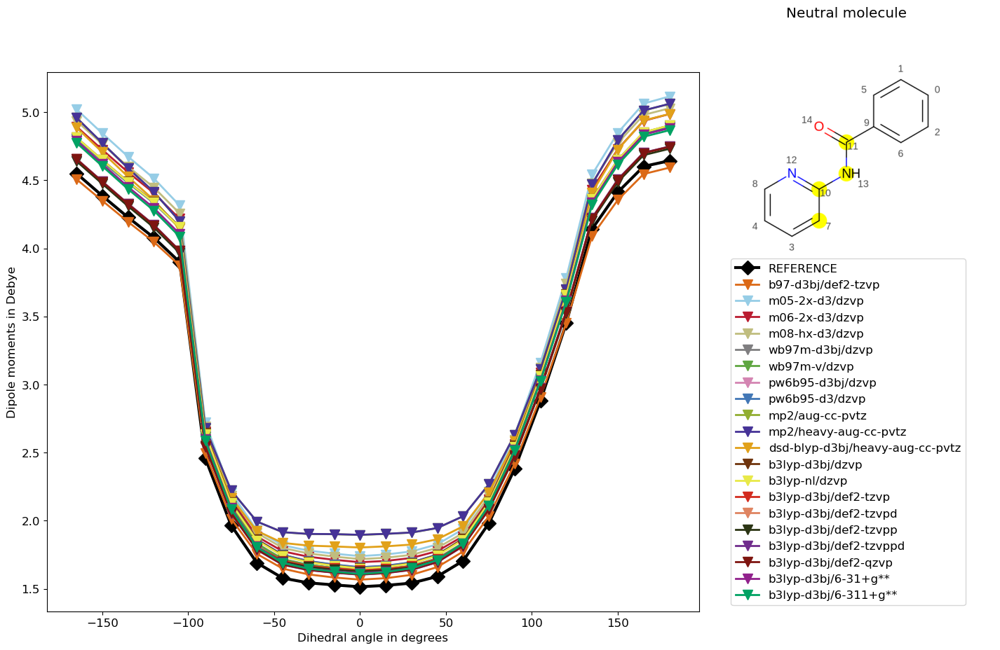

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

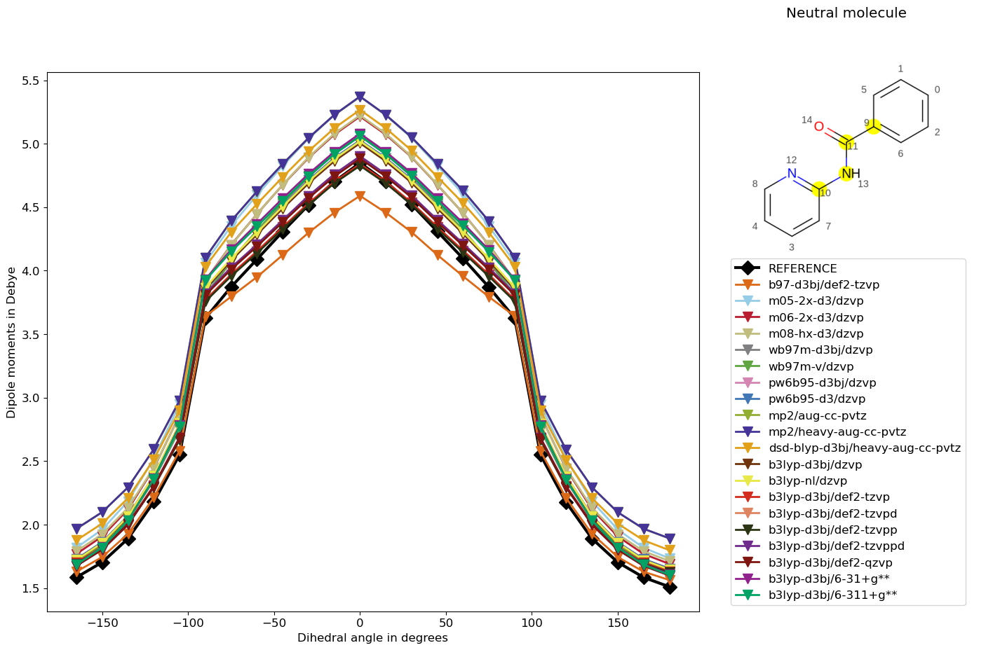

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

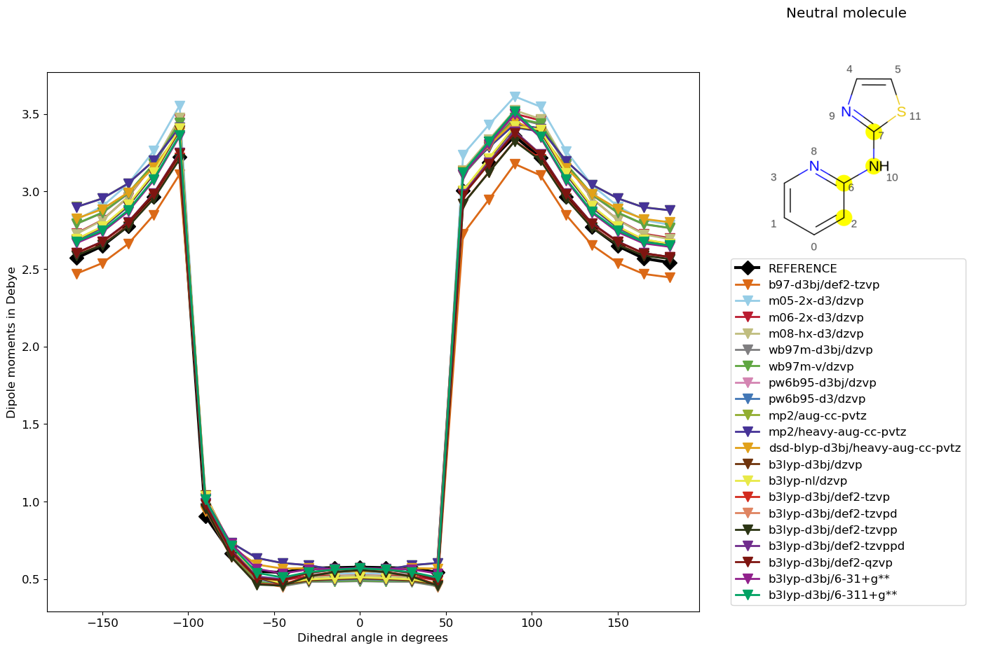

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

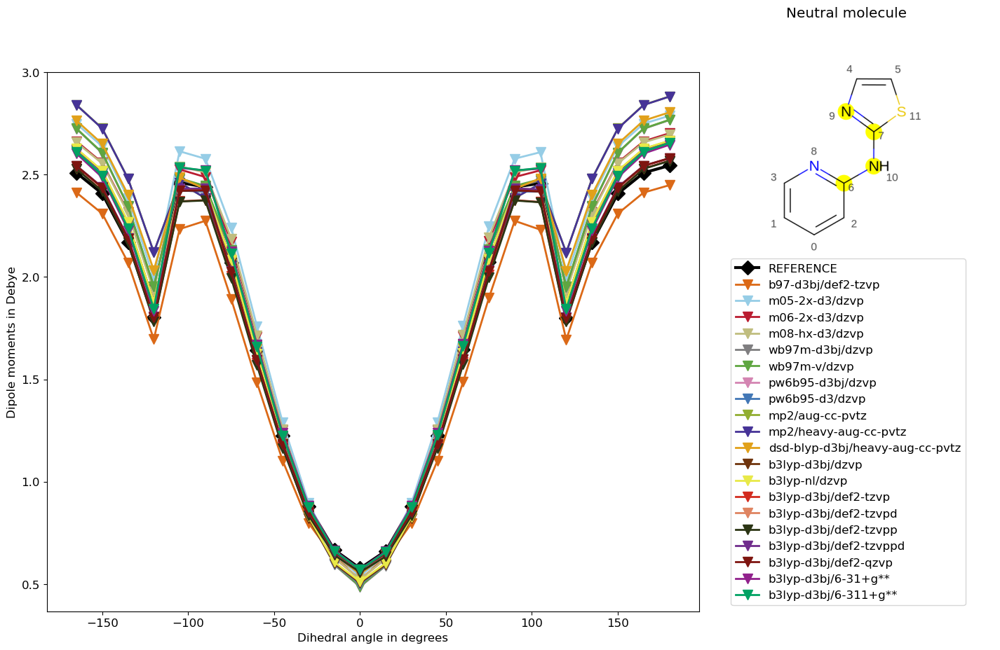

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

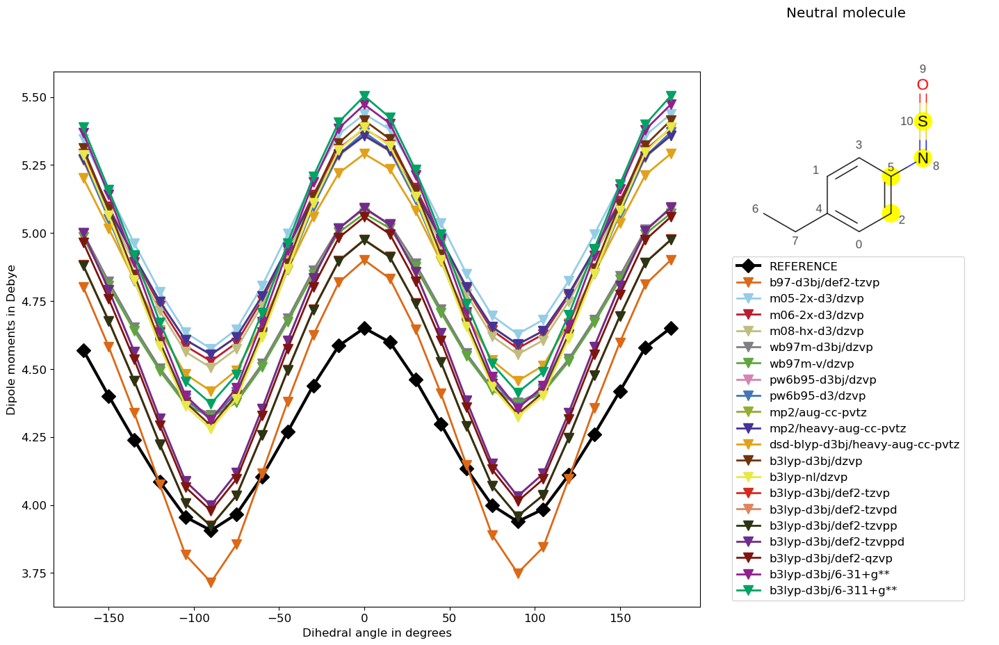

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

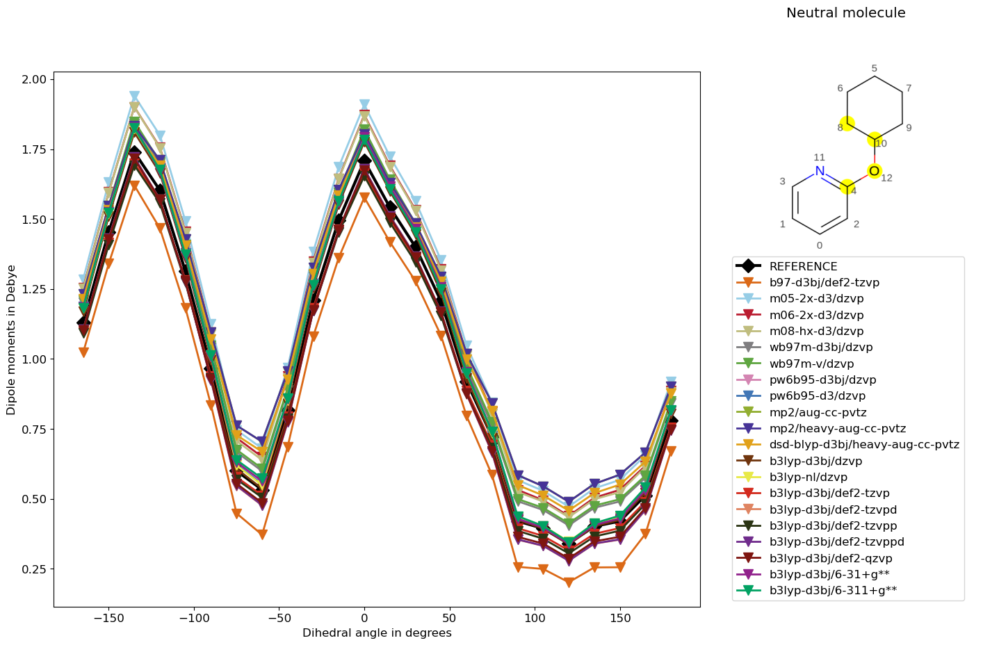

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

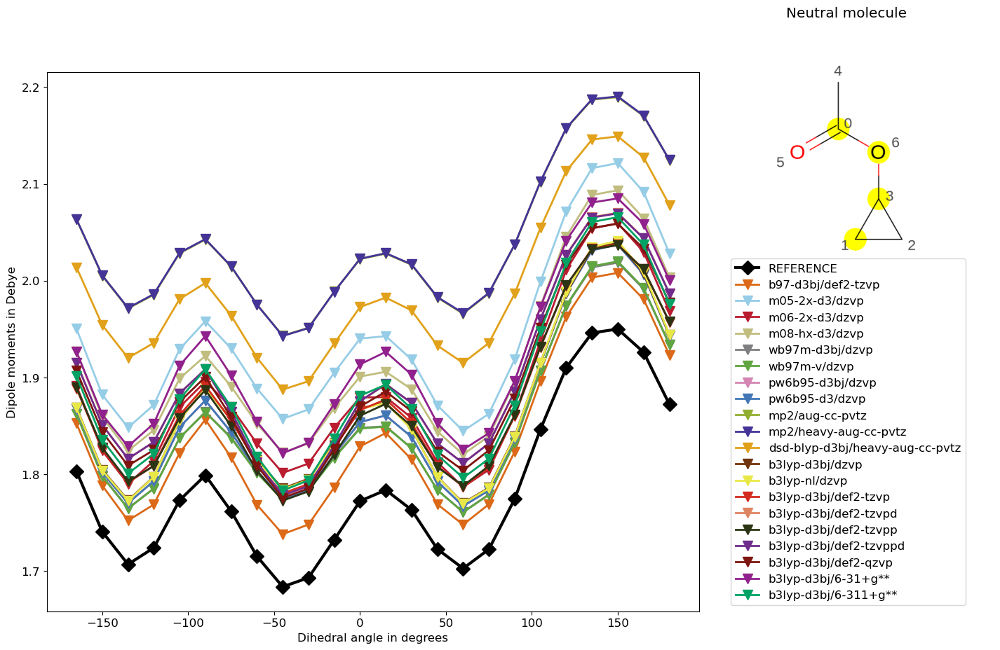

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

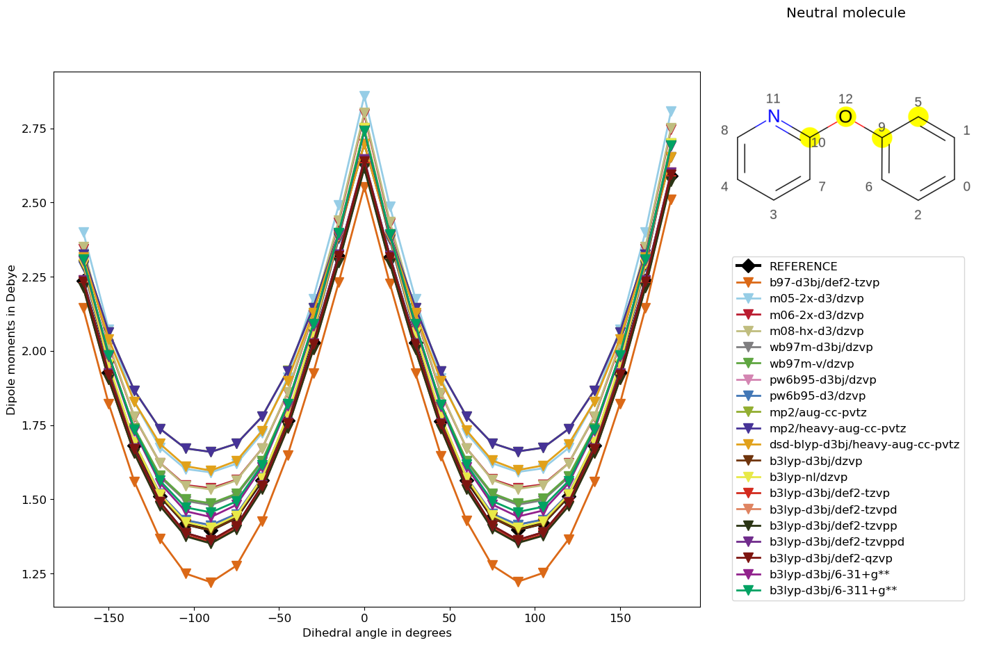

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

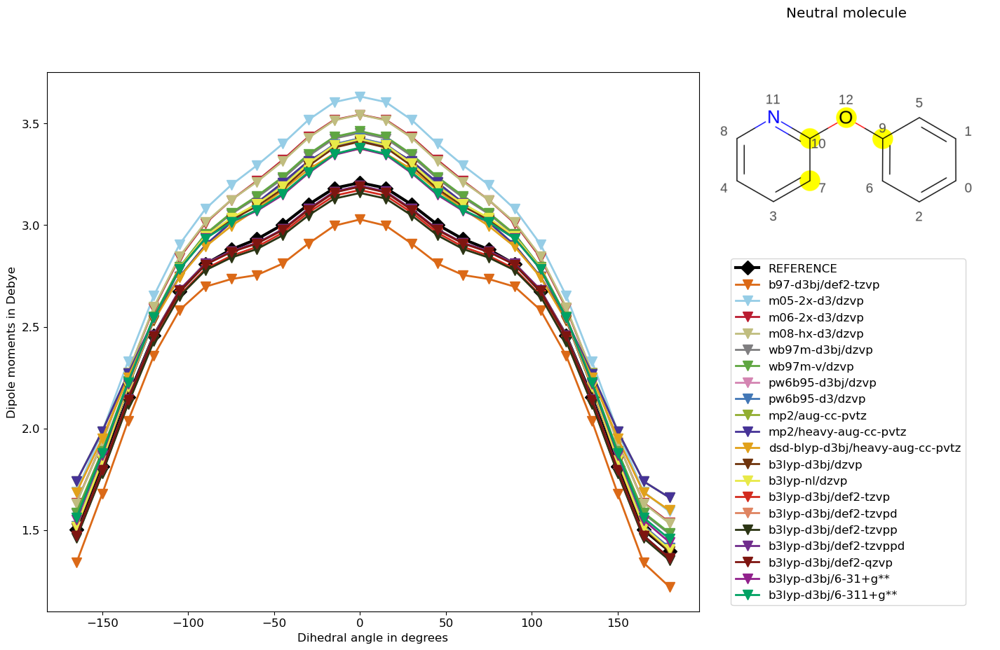

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

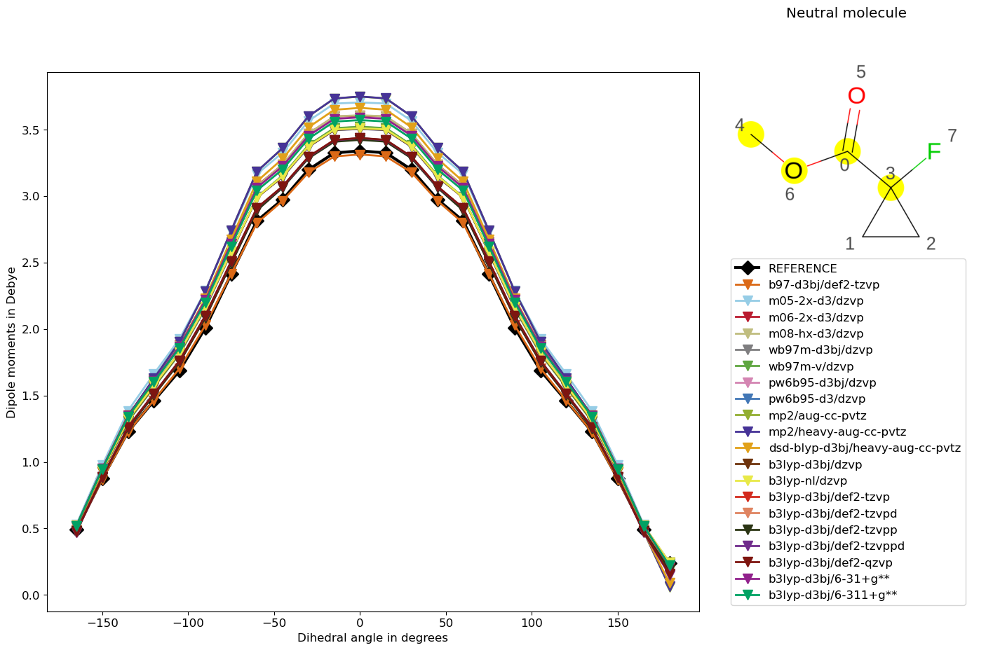

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

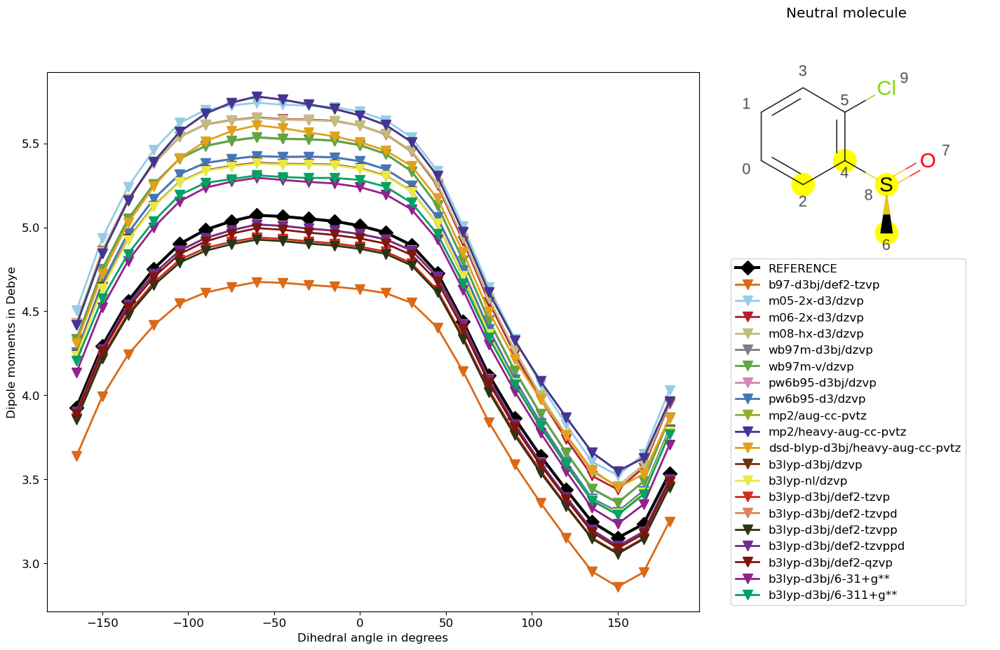

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

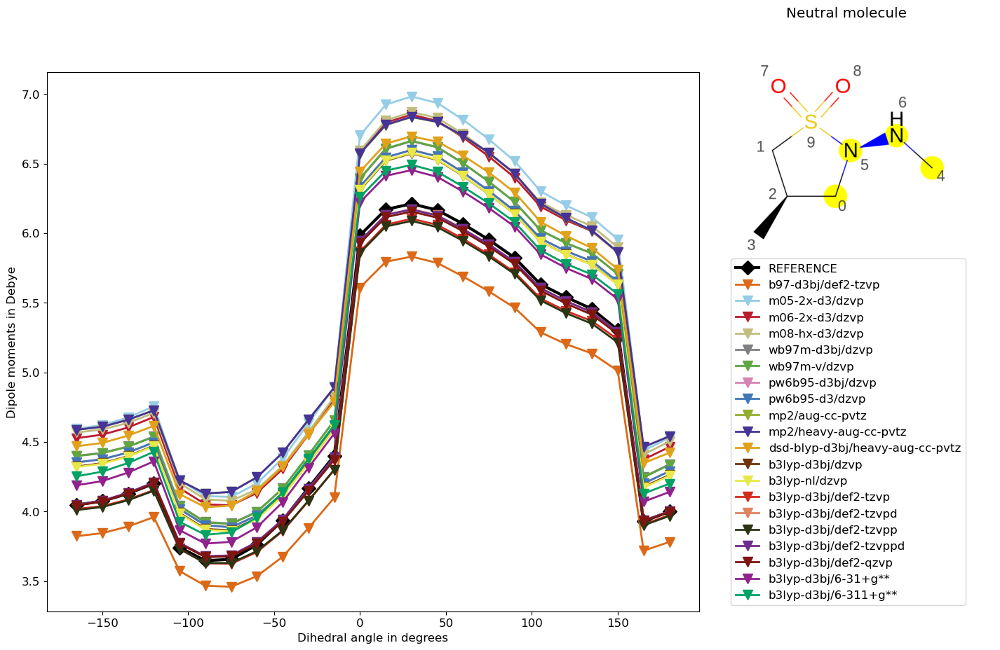

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

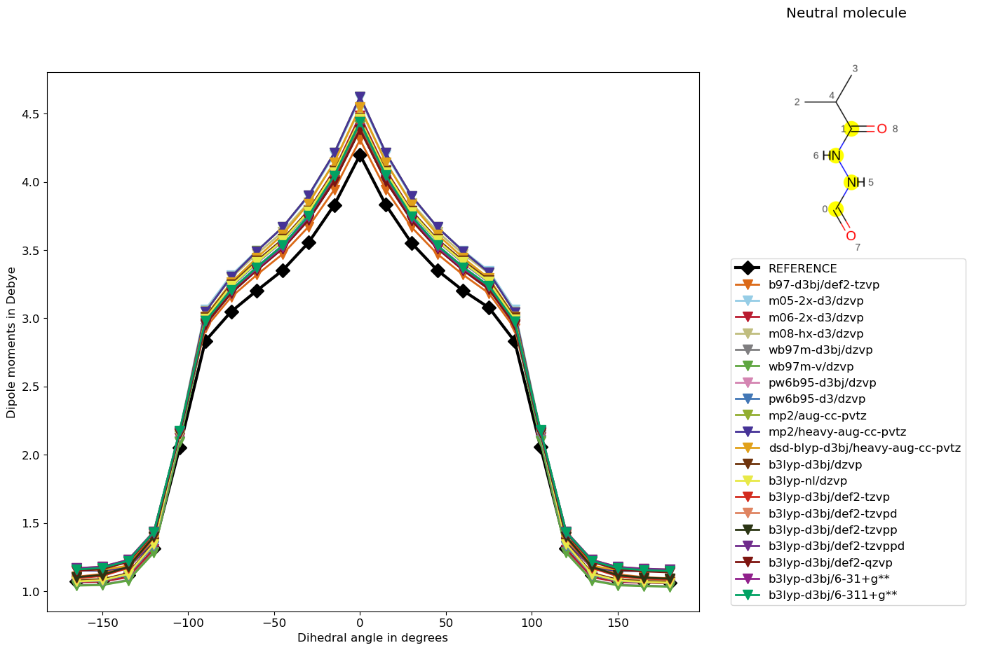

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

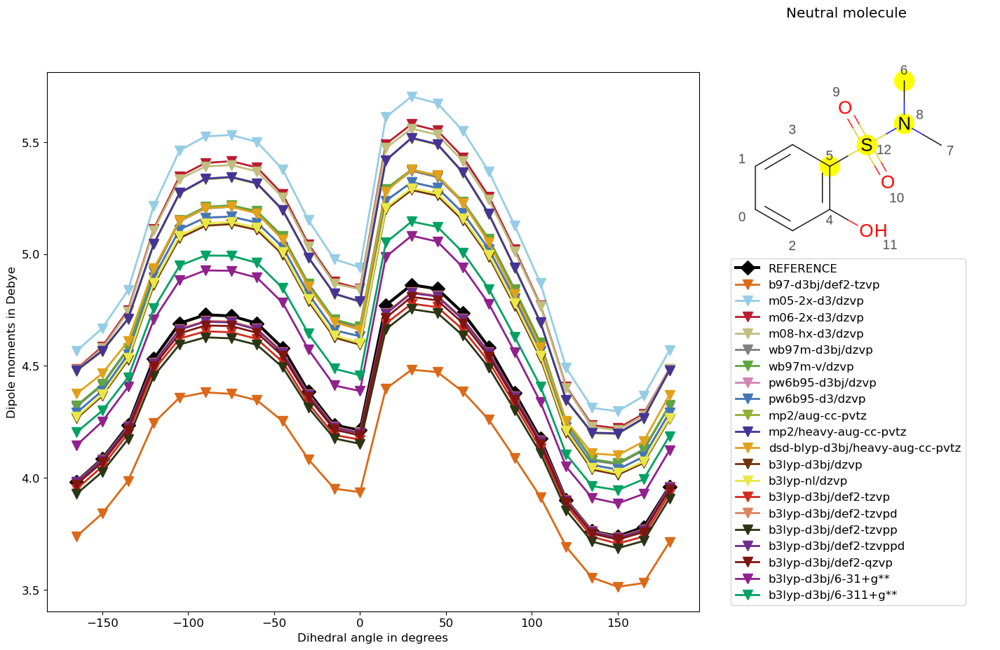

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

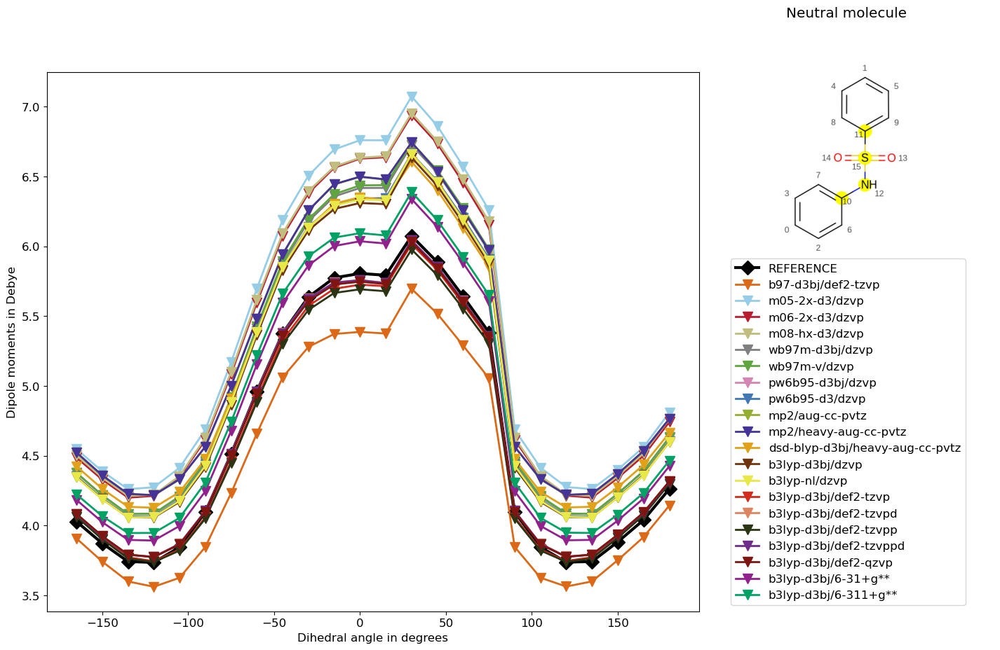

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

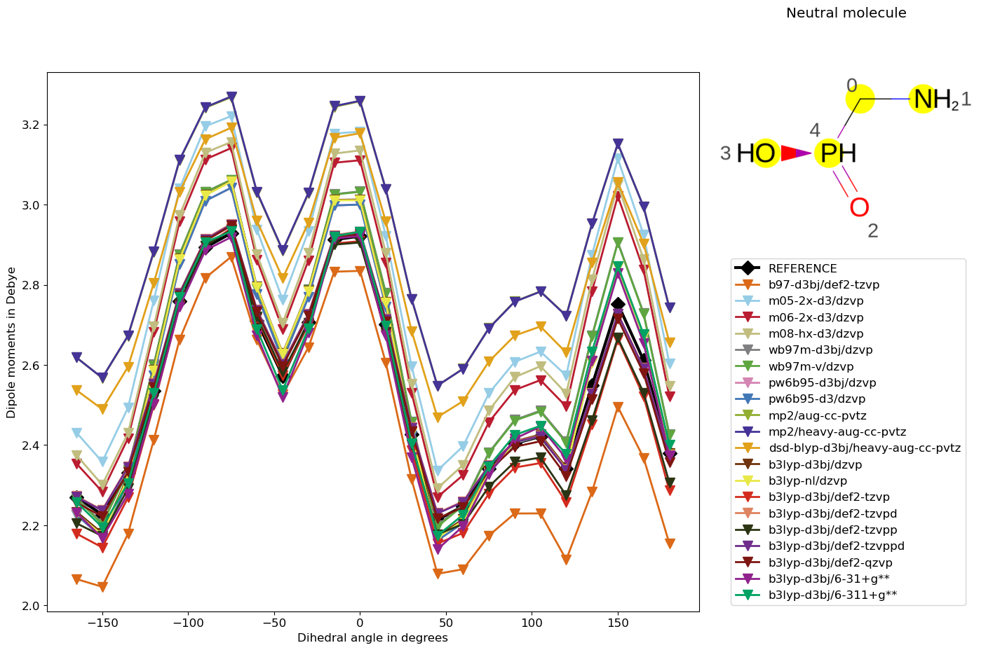

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

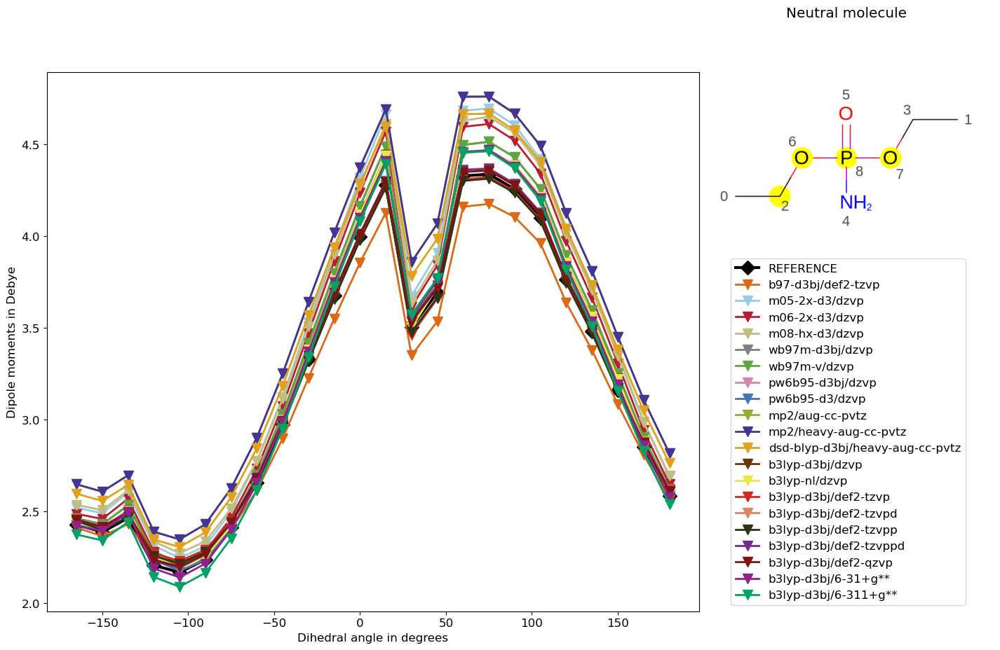

/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
/tmp/ipykernel_781488/3352448671.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ref_tran_vecs[df_ref_tran_vecs['index']

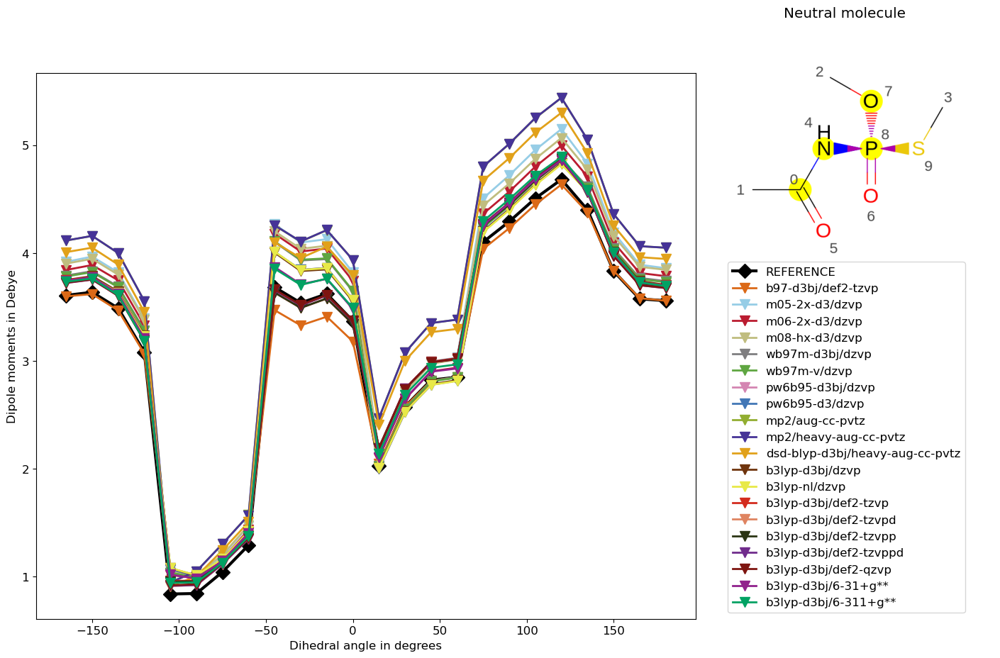

In [18]:
rmse = defaultdict(dict)
mae = defaultdict(dict)
table = []

with open('./data/'+REF_SPEC.replace('/','_')+'_single_points_data.json', 'r') as file:
        ref_dict = json.load(file)
with open('./data/MP2_heavy-aug-cc-pVTZ_torsiondrive_data.json', 'r') as file:
    mp2_data = json.load(file)

all_dipoles = defaultdict(list)
neutral_dipoles = defaultdict(list)
charged_dipoles = defaultdict(list)
neutral_ref = []
charged_ref = []
all_ref = []
rmse_dipole_dict = defaultdict(dict)
rmse_angle_dict = defaultdict(dict)
angle_dict = json.load(open("./data/angle_indices_for_single_points.json"))

df_ref = pd.read_csv("./data/ref_dipoles_cleaned.txt")
df_ref_tran_vecs = pd.read_csv("./data/translation_vectors.txt")

for i in range(59):
    dipole_ref_data = df_ref[df_ref['index'] == i].to_numpy()
    ref_angles = []
    ref_dipole_vectors = []
    ref_tran_vecs = []
    mapped_smiles = mp2_data[str(i)]['metadata']['mapped_smiles']
    dihedrals = mp2_data[str(i)]['metadata']['dihedral scanned'][0]
    mol_charge = mp2_data[str(i)]['metadata']['mol_charge']
    offmol = Molecule.from_mapped_smiles(mapped_smiles)
    for item in dipole_ref_data:
        ref_angles.append(item[1])
        ref_dipole_vectors.append(item[2:5])
        ref_tran_vecs.append(
            df_ref_tran_vecs[df_ref_tran_vecs['index'] == i][
                df_ref_tran_vecs[
                    'angle'] == item[1]].to_numpy()[0][2:5])

    ref_dipole_vectors = [(dip / ESU_BOHR_TO_DEBYE - tran * mol_charge) *
                   ESU_BOHR_TO_DEBYE
                   for dip, tran in zip(ref_dipole_vectors, ref_tran_vecs)]

    ref_angles, ref_dipole_vectors = zip(*sorted(zip(ref_angles, ref_dipole_vectors)))
    ref_dipole_moments = [np.linalg.norm(vec) for vec in ref_dipole_vectors]
    mu_diff_with_ref = defaultdict(float)
    angle_diff_with_ref = defaultdict(float)
    
    flag_neutral = True
    if mol_charge != 0:
        flag_neutral = False
    elif mol_charge == 0  and mapped_smiles.find('+') != -1:
        flag_neutral = False
    
    all_ref.extend(ref_dipole_moments)
    if flag_neutral:
        neutral_ref.extend(ref_dipole_moments)
    else:
        charged_ref.extend(ref_dipole_moments)
        
    fig, ax = plt.subplots(figsize=[12, 10])
    ax.plot(
            ref_angles,
            ref_dipole_moments,
            "-D",
            label="REFERENCE",
            linewidth=3.0,
            c="k",
            markersize=10,
        )
    for k, key in enumerate(keywords_list):
        if key == 'mp2/heavy-aug-cc-pvtz':
            angles = mp2_data[str(i)]['angles']
            dipole_vectors = np.array(mp2_data[str(i)]['dipoles']) * ESU_BOHR_TO_DEBYE
        else:
            with open('./data/'+key.replace('/','_')+'_single_points_data.json', 'r') as file:
                key_dict = json.load(file)
        
            angles = key_dict[str(i)]['angles']
            dipole_vectors = np.array(key_dict[str(i)]['dipoles']) * ESU_BOHR_TO_DEBYE
        dipole_moments = [np.linalg.norm(vec) for vec in dipole_vectors]
        all_dipoles[key].extend(dipole_moments)
        if flag_neutral:
            neutral_dipoles[key].extend(dipole_moments)
        else:
            charged_dipoles[key].extend(dipole_moments)

        dipole_moments = np.array(dipole_moments)
        ref_dipole_moments = np.array(ref_dipole_moments)
        rmse_dipoles = np.sqrt(np.mean((dipole_moments - ref_dipole_moments) ** 2))
        mae_dipoles = np.mean(np.abs(dipole_moments - ref_dipole_moments))
        rmse[i][key] = rmse_dipoles
        mae[i][key] = mae_dipoles
        ax.plot(
                angles,
                dipole_moments,
                "-v",
                label=key,
                linewidth=2.0,
                c=KELLYS_COLORS[k + 1],
                markersize=10,
            )
            
    
    plt.xlabel(
        "Dihedral angle in degrees",
    )
    plt.ylabel("Dipole moments in Debye")
    
    plt.legend(loc="lower left", bbox_to_anchor=(1.04, 0), fontsize=12)
    oemol = offmol.to_openeye()
    image = show_oemol_struc(
        oemol, torsions=True, atom_indices=dihedrals, width=600, height=500
    )
    img = Image.open(io.BytesIO(image.data))
    im_arr = np.asarray(img)
    newax = fig.add_axes([0.9, 0.6, 0.35, 0.35], anchor="SW", zorder=-1)
    newax.imshow(im_arr)
    newax.axis("off")
    if flag_neutral:
        plt.title('Neutral molecule')
    else:
        plt.title('Charged molecule')
    plt.show()
    pdf.savefig(fig, dpi=600, bbox_inches="tight")   

In [19]:
for k, key in enumerate(keywords_list):    
    all_ref = np.array(all_ref)
    method_energies = np.array(all_dipoles[key])
    rmse_stats = bootstrap_statistic(y_true=all_ref, y_pred=method_energies, statistic='RMSE')
    mue_stats = bootstrap_statistic(y_true=all_ref, y_pred=method_energies, statistic='MUE')   
    neutral_stats = bootstrap_statistic(y_true=neutral_ref, y_pred=np.array(neutral_dipoles[key]), statistic='RMSE')
    charged_stats = bootstrap_statistic(y_true=charged_ref, y_pred=np.array(charged_dipoles[key]), statistic='RMSE')
    lt_five_rmse_stats = bootstrap_statistic(y_true=all_ref[np.abs(all_ref) < 5], y_pred=method_energies[np.abs(all_ref) < 5], statistic='RMSE')
    lt_five_mue_stats = bootstrap_statistic(y_true=all_ref[np.abs(all_ref) < 5], y_pred=method_energies[np.abs(all_ref) < 5], statistic='MUE')
    table.append([key,
                  "%.4f" % rmse_stats['mle'],"%.4f" % rmse_stats['low'],"%.4f" % rmse_stats['high'],
                  "%.4f" % mue_stats['mle'],"%.4f" % mue_stats['low'],"%.4f" % mue_stats['high'],
                  "%.4f" % neutral_stats['mle'],"%.4f" % neutral_stats['low'],"%.4f" % neutral_stats['high'],
                  "%.4f" % charged_stats['mle'],"%.4f" % charged_stats['low'],"%.4f" % charged_stats['high'],
                  "%.4f" % lt_five_rmse_stats['mle'],"%.4f" % lt_five_rmse_stats['low'],"%.4f" % lt_five_rmse_stats['high']])

/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-pa

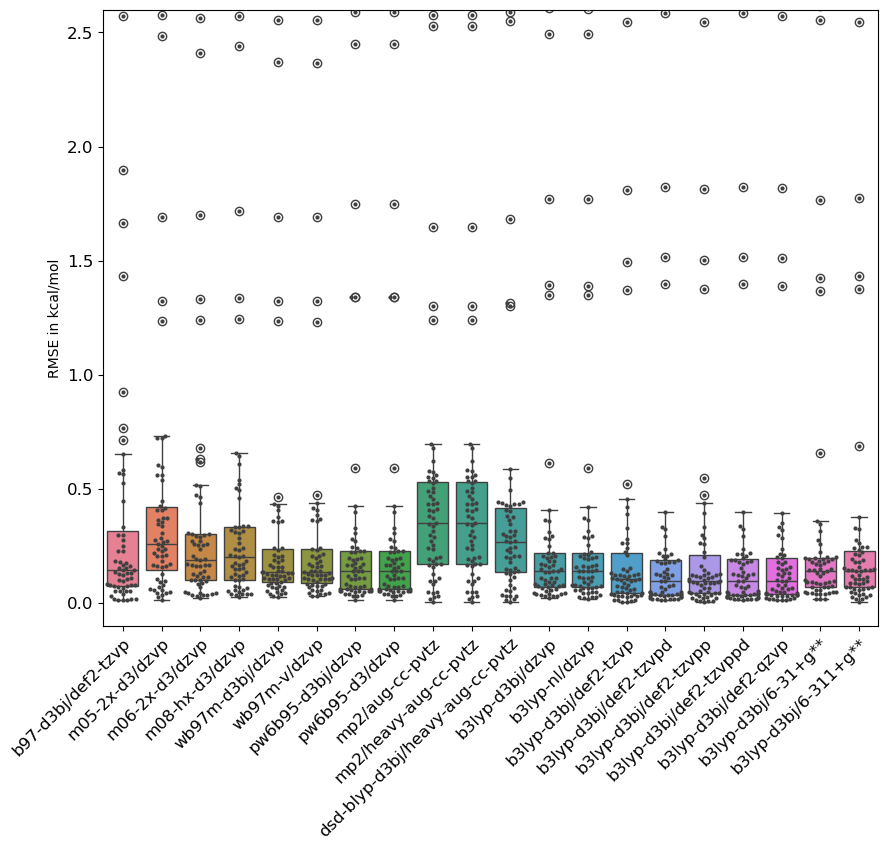

/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-pa

| Specification                   |   RMSE in kcal/mol |   low 95% ci |   high 95% ci |   MAE in kcal/mol |   low 95% ci |   high 95% ci |   Neutral RMSE in kcal/mol |   low 95% ci |   high 95% ci |   Charged RMSE in kcal/mol |   low 95% ci |   high 95% ci |   lt_five_RMSE in kcal/mol |   low 95% ci |   high 95% ci |
|---------------------------------+--------------------+--------------+---------------+-------------------+--------------+---------------+----------------------------+--------------+---------------+----------------------------+--------------+---------------+----------------------------+--------------+---------------|
| b97-d3bj/def2-tzvp              |             0.6754 |       0.5898 |        0.7639 |            0.324  |       0.2942 |        0.3562 |                     0.1572 |       0.1493 |        0.1657 |                     0.9499 |       0.8306 |        1.0703 |                     0.147  |       0.1401 |        0.1538 |
| m05-2x-d3/dzvp                  |        

/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:3398: UserWarning: 25.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:3398: UserWarning: 11.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:3398: UserWarning: 20.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/maverick/miniconda3/envs/benchmark/lib/python3.11/site-packages/seaborn/categorical.py:3398: UserWarning: 16.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarni

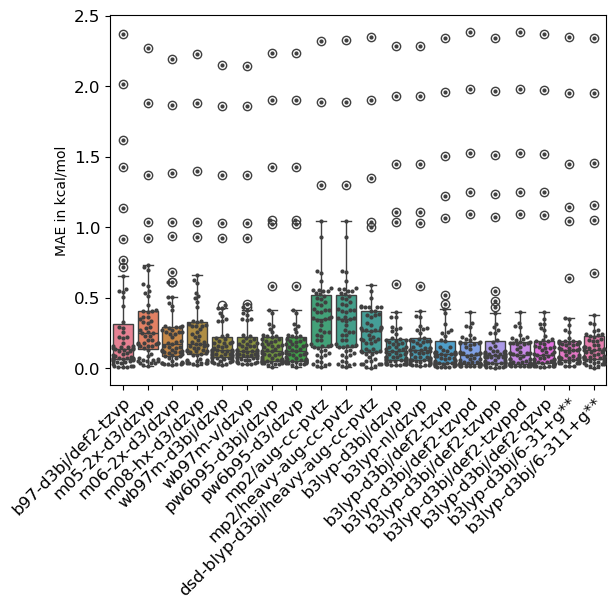

In [20]:
# RMSE, MAE
fig, ax = plt.subplots(figsize=[10, 8])
# Width of a bar
width = 0.25

tmp_df = pd.DataFrame(rmse)
df = tmp_df.T
ax = sns.boxplot(data=df)
ax = sns.swarmplot(data=df, size=3, color="0.25")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
ax.xaxis.get_label().set_fontsize(12)
ax.set(ylabel="RMSE in kcal/mol")
ax.yaxis.get_label().set_fontsize(10)
ax.set_ylim(-0.1, 2.6)
fig = ax.get_figure()
plt.savefig('./data/rmse-b3lyp-neutral.png',dpi=600,
            bbox_inches="tight")
plt.show()
pdf.savefig(fig, dpi=600, bbox_inches="tight")

tmp_df = pd.DataFrame(mae)
df = tmp_df.T
ax = sns.boxplot(data=df)
ax = sns.swarmplot(data=df, size=3, color="0.25")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
ax.xaxis.get_label().set_fontsize(12)
ax.set(ylabel="MAE in kcal/mol")
ax.yaxis.get_label().set_fontsize(10)
fig = ax.get_figure()
pdf.savefig(fig, dpi=600, bbox_inches="tight")
pdf.close()

print(
    tabulate(
        table,
        headers=["Specification", 
                 "RMSE in kcal/mol", "low 95% ci", "high 95% ci", 
                 "MAE in kcal/mol", "low 95% ci", "high 95% ci", 
                 "Neutral RMSE in kcal/mol", "low 95% ci", "high 95% ci", 
                 "Charged RMSE in kcal/mol", "low 95% ci", "high 95% ci", 
                 "lt_five_RMSE in kcal/mol", "low 95% ci", "high 95% ci"],
        tablefmt="orgtbl",
    )
)
print("* closer to zero the better")

with open("./output/rmse_scores_test.txt", "w") as f:
    f.write("Using " + REF_SPEC + " as a reference method the scores are: \n")
    f.write(
        tabulate(
            table,
            headers=["Specification", "RMSE in kcal/mol", "MAE in kcal/mol"],
            tablefmt="orgtbl",
        )
    )
    f.write("\n")
    f.write("* closer to zero the better")

In [21]:
# For latex table entries
print("RMSE MUE TRR")
for item in table:
    print(
        f"{item[0].upper()} & ${{{item[1]}}}^{{{item[2]}}}_{{{item[3]}"
        f"}}$ & ${{{item[4]}}}^{{{item[5]}}}_{{{item[6]}}}$ & ${{{item[13]}}}^{{{item[14]}}}_{{{item[15]}}}$\\\\ \\vspace{{2mm}}")


RMSE MUE TRR
B97-D3BJ/DEF2-TZVP & ${0.6754}^{0.5898}_{0.7639}$ & ${0.3240}^{0.2942}_{0.3562}$ & ${0.1470}^{0.1401}_{0.1538}$\\ \vspace{2mm}
M05-2X-D3/DZVP & ${0.6497}^{0.5682}_{0.7434}$ & ${0.3643}^{0.3365}_{0.3904}$ & ${0.3414}^{0.3239}_{0.3574}$\\ \vspace{2mm}
M06-2X-D3/DZVP & ${0.6172}^{0.5258}_{0.7087}$ & ${0.3098}^{0.2838}_{0.3363}$ & ${0.2791}^{0.2636}_{0.2951}$\\ \vspace{2mm}
M08-HX-D3/DZVP & ${0.6245}^{0.5412}_{0.7180}$ & ${0.3200}^{0.2935}_{0.3485}$ & ${0.2848}^{0.2702}_{0.2980}$\\ \vspace{2mm}
WB97M-D3BJ/DZVP & ${0.5877}^{0.4984}_{0.6906}$ & ${0.2630}^{0.2357}_{0.2910}$ & ${0.1944}^{0.1838}_{0.2061}$\\ \vspace{2mm}
WB97M-V/DZVP & ${0.5877}^{0.4991}_{0.6821}$ & ${0.2634}^{0.2378}_{0.2932}$ & ${0.1950}^{0.1836}_{0.2058}$\\ \vspace{2mm}
PW6B95-D3BJ/DZVP & ${0.5998}^{0.5069}_{0.6923}$ & ${0.2570}^{0.2280}_{0.2873}$ & ${0.1999}^{0.1859}_{0.2131}$\\ \vspace{2mm}
PW6B95-D3/DZVP & ${0.5998}^{0.5055}_{0.6959}$ & ${0.2570}^{0.2309}_{0.2888}$ & ${0.1999}^{0.1852}_{0.2136}$\\ \vspace{2mm

In [22]:
# For latex table entries
print("RMSE Neutral Charged")
for item in table:
    print(
        f"{item[0].upper()} & ${{{item[1]}}}^{{{item[2]}}}_{{{item[3]}"
        f"}}$ & ${{{item[7]}}}^{{{item[8]}}}_{{{item[9]}}}$ & ${{{item[10]}}}^{{{item[11]}}}_{{{item[12]}}}$\\\\ \\vspace{{2mm}}")

RMSE Neutral Charged
B97-D3BJ/DEF2-TZVP & ${0.6754}^{0.5898}_{0.7639}$ & ${0.1572}^{0.1493}_{0.1657}$ & ${0.9499}^{0.8306}_{1.0703}$\\ \vspace{2mm}
M05-2X-D3/DZVP & ${0.6497}^{0.5682}_{0.7434}$ & ${0.3765}^{0.3590}_{0.3933}$ & ${0.8439}^{0.7144}_{0.9845}$\\ \vspace{2mm}
M06-2X-D3/DZVP & ${0.6172}^{0.5258}_{0.7087}$ & ${0.3071}^{0.2914}_{0.3250}$ & ${0.8231}^{0.6850}_{0.9627}$\\ \vspace{2mm}
M08-HX-D3/DZVP & ${0.6245}^{0.5412}_{0.7180}$ & ${0.3163}^{0.3015}_{0.3323}$ & ${0.8307}^{0.6855}_{0.9643}$\\ \vspace{2mm}
WB97M-D3BJ/DZVP & ${0.5877}^{0.4984}_{0.6906}$ & ${0.2156}^{0.2034}_{0.2275}$ & ${0.8091}^{0.6676}_{0.9523}$\\ \vspace{2mm}
WB97M-V/DZVP & ${0.5877}^{0.4991}_{0.6821}$ & ${0.2166}^{0.2053}_{0.2287}$ & ${0.8089}^{0.6621}_{0.9436}$\\ \vspace{2mm}
PW6B95-D3BJ/DZVP & ${0.5998}^{0.5069}_{0.6923}$ & ${0.2162}^{0.2033}_{0.2294}$ & ${0.8267}^{0.6830}_{0.9617}$\\ \vspace{2mm}
PW6B95-D3/DZVP & ${0.5998}^{0.5055}_{0.6959}$ & ${0.2162}^{0.2037}_{0.2288}$ & ${0.8267}^{0.7011}_{0.9614}$\\ \vs